In [1]:
library(Seurat)
library(ggplot2)

Attaching SeuratObject



In [2]:
library(tidyverse)

Warning message in system("timedatectl", intern = TRUE):
“running command 'timedatectl' had status 1”
── Attaching core tidyverse packages ──────────────────────── tidyverse 2.0.0 ──
✔ dplyr     1.1.4     ✔ readr     2.1.5
✔ forcats   1.0.0     ✔ stringr   1.5.1
✔ lubridate 1.9.2     ✔ tibble    3.2.1
✔ purrr     1.0.2     ✔ tidyr     1.3.1
── Conflicts ────────────────────────────────────────── tidyverse_conflicts() ──
✖ dplyr::filter() masks stats::filter()
✖ dplyr::lag()    masks stats::lag()
ℹ Use the conflicted package (<http://conflicted.r-lib.org/>) to force all conflicts to become errors


In [3]:
obj_adult = readRDS("/data/input/Files/FB_data/scRNA_FB_20240703/Adult_FB_fig1_merge_harmony.rds")
obj_adult

An object of class Seurat 
27707 features across 15156 samples within 1 assay 
Active assay: RNA (27707 features, 3000 variable features)
 3 dimensional reductions calculated: pca, harmony, umap

In [ ]:
obj_ep = readRDS("/data/input/Files/FB_data/scRNA_FB_20240703/EP_FB_fig1_merge_harmony.rds")
obj_ep

In [ ]:
1

In [ ]:
obj_fascia = readRDS("/data/input/Files/FB_data/scRNA_FB_20240703/fascia_Reduc.rds")
obj_fascia

In [13]:
table(obj_fascia$celltype)


FB_fascia_1_Adult FB_fascia_2_Adult      FB_fascia_EP 
             1550               809             25737 

In [14]:
data = cbind(as.data.frame(obj_fascia@reductions$fascia@cell.embeddings), obj_fascia$celltype)
colnames(data)= c("Fascia_1", "Fascia_2", "celltype")
head(data)

,Fascia_1,Fascia_2,celltype
,<dbl>,<dbl>,<chr>
RNA_r_Adult_10D_F1_1_2_CELL46_N4,0.5832682,0.5190354,FB_fascia_1_Adult
RNA_r_Adult_10D_F1_1_2_CELL169_N2,0.5528242,0.6253152,FB_fascia_1_Adult
RNA_r_Adult_10D_F1_1_2_CELL351_N3,0.8175399,0.4962391,FB_fascia_1_Adult
RNA_r_Adult_10D_F1_1_2_CELL474_N2,0.6752408,0.4558588,FB_fascia_1_Adult
RNA_r_Adult_10D_F1_1_2_CELL622_N2,0.6406996,0.5680589,FB_fascia_1_Adult
RNA_r_Adult_10D_F1_1_2_CELL624_N2,0.5413445,0.6202019,FB_fascia_1_Adult


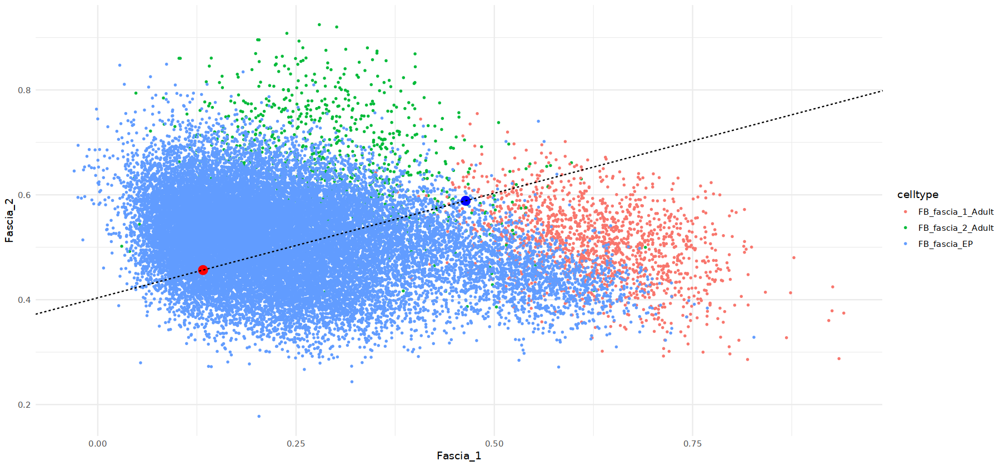

In [15]:
# 计算中心点
a = data[data$celltype == "FB_fascia_EP" & obj_fascia$Age_TimePostInjury=="E16.5_Nor",]
b1 = data[data$celltype == "FB_fascia_1_Adult",]
b2 = data[data$celltype == "FB_fascia_2_Adult",]
center_a <- data.frame(x = mean(a$Fascia_1), y = mean(a$Fascia_2))
center_b1 <- data.frame(x = mean(b1$Fascia_1), y = mean(b1$Fascia_2))
center_b2 <- data.frame(x = mean(b2$Fascia_1), y = mean(b2$Fascia_2))

# 计算b1和b2中心连线的中点
midpoint_b1_b2 <- data.frame(x = (center_b1$x + center_b2$x) / 2, y = (center_b1$y + center_b2$y) / 2)

# 计算直线的斜率和截距
slope <- (midpoint_b1_b2$y - center_a$y) / (midpoint_b1_b2$x - center_a$x)
intercept <- center_a$y - slope * center_a$x

# 绘制散点图
p <- ggplot(data, aes(x = Fascia_1, y = Fascia_2, color = celltype)) +
  geom_point(size = 0.5) +
  theme_minimal()

# 添加中心点和中点
p <- p + 
  geom_point(data = center_a, aes(x = x, y = y), color = "red", size = 4) +
  geom_point(data = midpoint_b1_b2, aes(x = x, y = y), color = "blue", size = 4)

# 添加a中心点到b1和b2中心连线中点的直线
p <- p + geom_abline(slope = slope, intercept = intercept, linetype = "dashed", color = "black")

# 显示图形
print(p)

In [16]:
# 定义分类函数
classify_point <- function(x, y, slope, intercept) {
  # 计算点到直线的垂直距离
  distance <- y - (slope * x + intercept)
  if (distance > 0) {
    return("fascia2")
  } else {
    return("fascia1")
  }
}

# 对所有点进行分类
data$class <- mapply(classify_point, data$Fascia_1, data$Fascia_2, MoreArgs = list(slope = slope, intercept = intercept))
obj_fascia$class = data$class
table(obj_fascia$class, obj_fascia$celltype)

         
          FB_fascia_1_Adult FB_fascia_2_Adult FB_fascia_EP
  fascia1              1461                87        10090
  fascia2                89               722        15647

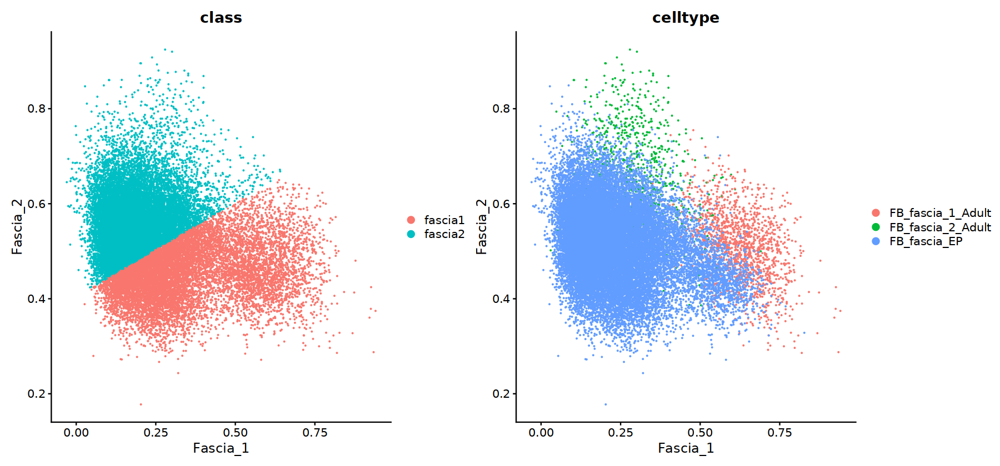

In [17]:
options(repr.plot.width = 15, repr.plot.height = 7)
DimPlot(obj_fascia, reduction='fascia', group.by="class") + DimPlot(obj_fascia, reduction='fascia', group.by="celltype")

In [ ]:
color_df = read.csv("/jdfssz1/ST_SUPERCELLS/P21Z10200N0171/Project/SkinFullyInjury/02.ST/07.sc_st_trans/06.iter_tacco2/tacco3/FB_240520/Python_plot/Fig2_color_seq_20240521.csv", row.names=1)
colors = color_df$colors
names(colors) = rownames(color_df)
p <- DimPlot(obj_fascia, reduction='fascia', group.by="celltype", cols=colors, pt.size=0.5) + theme(panel.background = element_rect(fill = "black"),
plot.background = element_rect(fill = "black"),
# text = element_text(color = "white", size=1),
plot.title = element_text(color = "white"),
panel.grid=element_blank(),#strip.text = element_blank(),
panel.border = element_rect(fill=NA,color="white", size=1, linetype="solid")) + NoLegend()
ggsave(plot=p,"fascia_celltype_black_240906.pdf")

Saving 6.67 x 6.67 in image


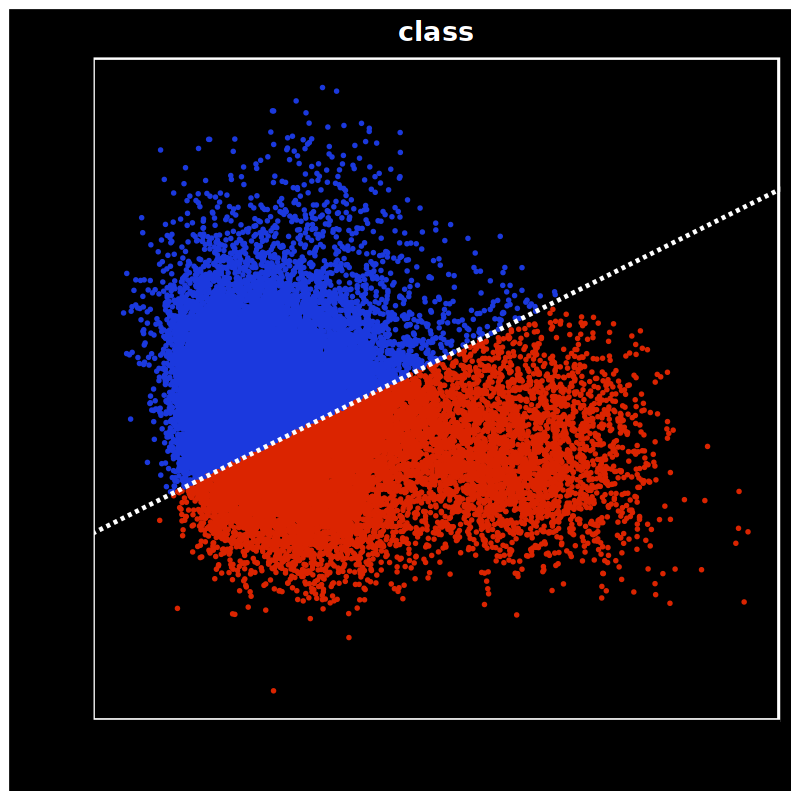

In [25]:
colors = c("#db2400", "#1B39DE")
names(colors) = c("fascia1", "fascia2")
p <- DimPlot(obj_fascia, reduction='fascia', group.by="class", cols=colors, pt.size=0.5) + theme(panel.background = element_rect(fill = "black"),
plot.background = element_rect(fill = "black"),
# text = element_text(color = "white", size=1),
plot.title = element_text(color = "white"),
panel.grid=element_blank(),#strip.text = element_blank(),
panel.border = element_rect(fill=NA,color="white", size=1, linetype="solid")) + NoLegend()
# # 添加中心点和中点
# p <- p + 
#   geom_point(data = center_a, aes(x = x, y = y), color = "white", size = 4) +
#   geom_point(data = midpoint_b1_b2, aes(x = x, y = y), color = "white", size = 4)

# 添加a中心点到b1和b2中心连线中点的直线
p <- p + geom_abline(slope = slope, intercept = intercept, linetype = "dashed", color = "white",linewidth=1)
ggsave(plot=p,"fascia_class_black_241015.pdf")
options(repr.plot.width = 6.67, repr.plot.height = 6.67)
p

In [10]:
age_df = data.frame(row.names = c("E16.5", "E17.5", "E18.5", "P0", "P5", "Nor", "6H", "1D", "2D", "3D", "5D", "6D"),
                         time = c(16.5, 17.5, 18.5, 22, 27,0, 0.25, 1, 2, 3, 5, 6))

obj_fascia$RealTime = age_df[obj_fascia$Age,'time'] + age_df[obj_fascia$TimePostInjury,'time']
obj_fascia$RealTime[obj_fascia$TimePostInjury=="Born"] = 22
obj_fascia$RealTime[obj_fascia$Age=="Adult"] = 40

In [11]:
library(FNN)

v = knn.reg(obj_fascia@reductions$fascia@cell.embeddings, y=obj_fascia$RealTime, k=20)
obj_fascia$esti = v$pred

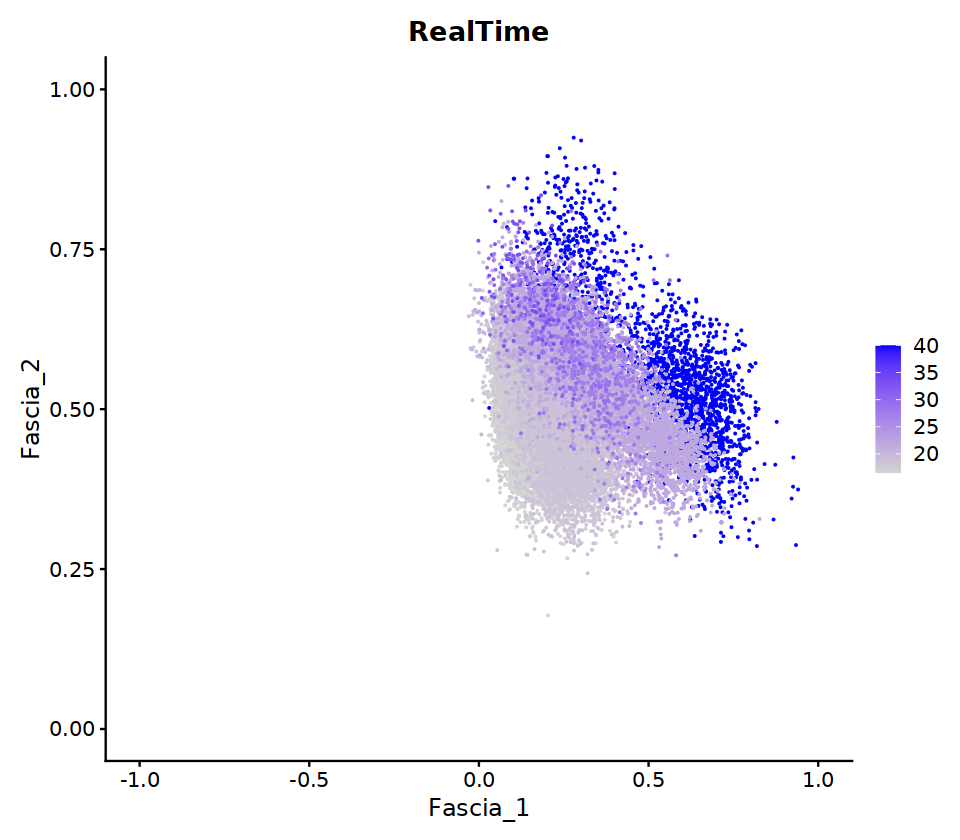

In [12]:
FeaturePlot(obj_fascia, reduction='fascia', features="RealTime")

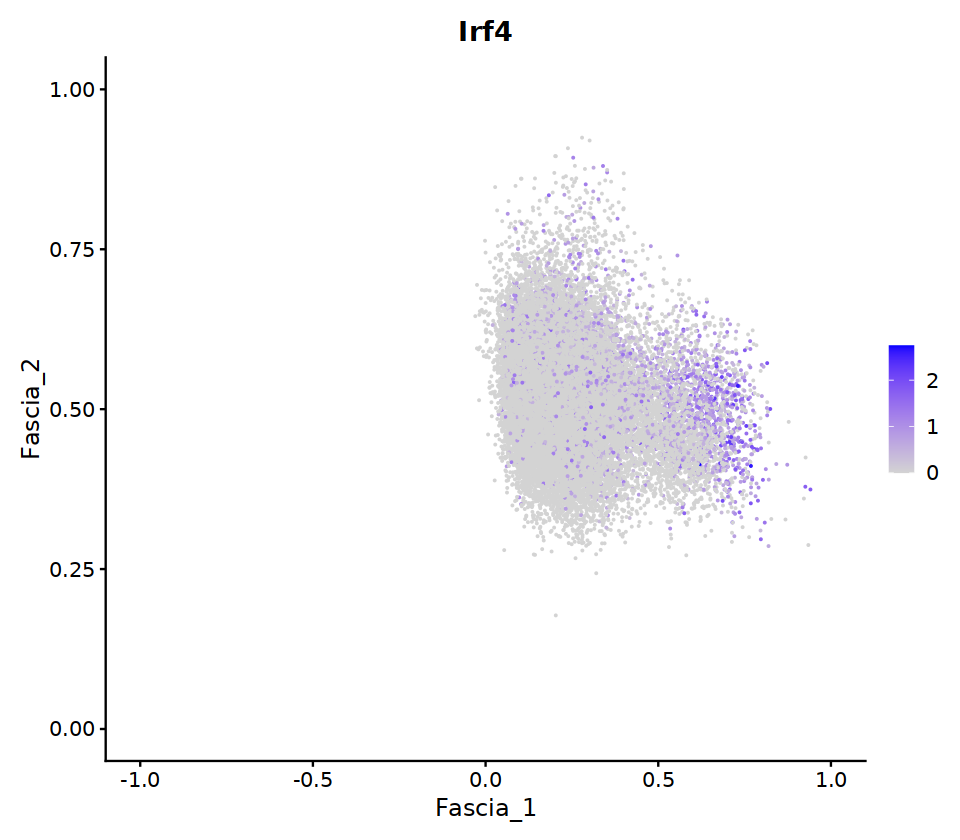

In [13]:
FeaturePlot(obj_fascia, reduction='fascia', features="Irf4")

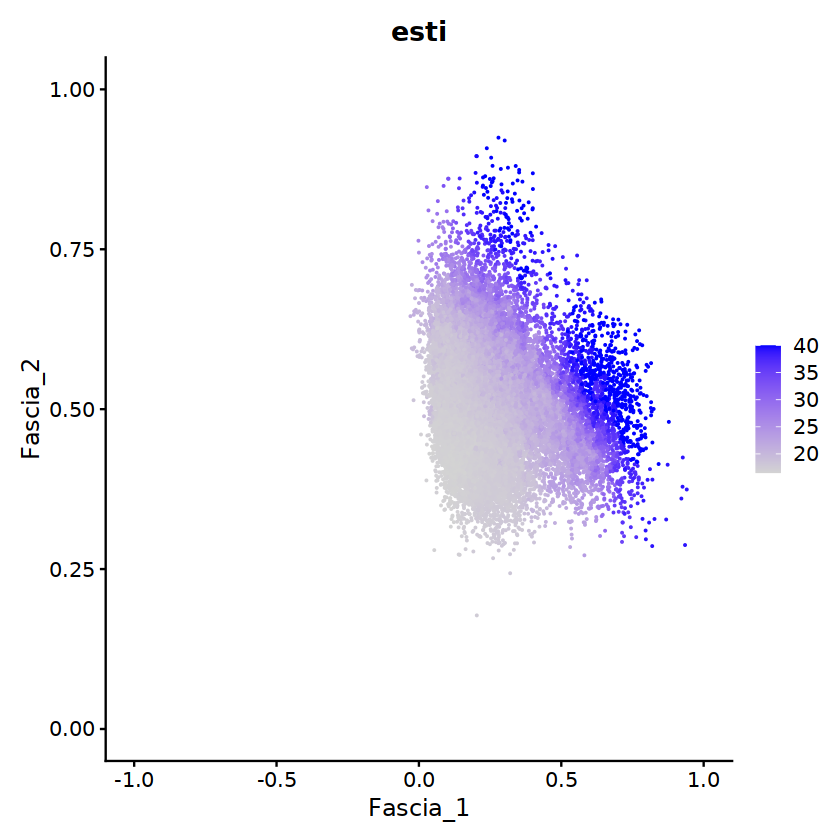

In [34]:
FeaturePlot(obj_fascia, reduction='fascia', features="esti")

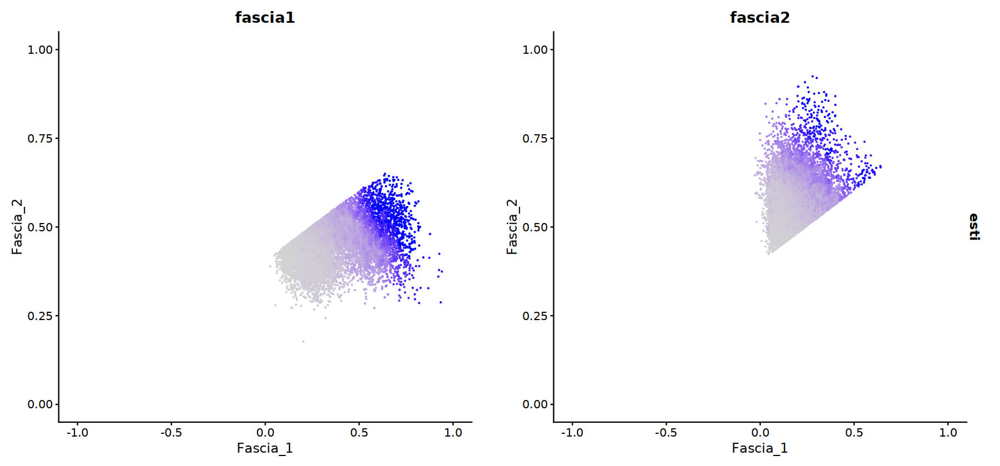

In [12]:
options(repr.plot.width = 15, repr.plot.height = 7)
FeaturePlot(obj_fascia, reduction='fascia', features="esti", split.by="class")

In [14]:
genes = rownames(obj_fascia)

In [15]:
obj_f1 = subset(obj_fascia, class == "fascia1")
obj_f1$rank = ntile(obj_f1$esti, n=100)
table(obj_f1$rank)


  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18  19  20 
117 117 117 117 117 117 117 117 117 117 117 117 117 117 117 117 117 117 117 117 
 21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40 
117 117 117 117 117 117 117 117 117 117 117 117 117 117 117 117 117 117 116 116 
 41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60 
116 116 116 116 116 116 116 116 116 116 116 116 116 116 116 116 116 116 116 116 
 61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78  79  80 
116 116 116 116 116 116 116 116 116 116 116 116 116 116 116 116 116 116 116 116 
 81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96  97  98  99 100 
116 116 116 116 116 116 116 116 116 116 116 116 116 116 116 116 116 116 116 116 

In [16]:
obj_f1_ = subset(obj_fascia, class == "fascia1" & TimePostInjury == "Nor")
obj_f1_$rank = ntile(obj_f1_$esti, n=100)
table(obj_f1_$rank)


  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18  19  20 
 43  43  43  43  43  43  43  43  43  43  43  43  43  43  43  43  43  43  43  43 
 21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40 
 43  43  43  43  43  43  43  43  43  43  43  43  43  43  43  43  43  43  43  43 
 41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60 
 43  43  43  43  43  43  43  42  42  42  42  42  42  42  42  42  42  42  42  42 
 61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78  79  80 
 42  42  42  42  42  42  42  42  42  42  42  42  42  42  42  42  42  42  42  42 
 81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96  97  98  99 100 
 42  42  42  42  42  42  42  42  42  42  42  42  42  42  42  42  42  42  42  42 

In [17]:
obj_f2 = subset(obj_fascia, class == "fascia2")
obj_f2$rank = ntile(obj_f2$esti, n=100)
table(obj_f2$rank)


  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18  19  20 
165 165 165 165 165 165 165 165 165 165 165 165 165 165 165 165 165 165 165 165 
 21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40 
165 165 165 165 165 165 165 165 165 165 165 165 165 165 165 165 165 165 165 165 
 41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60 
165 165 165 165 165 165 165 165 165 165 165 165 165 165 165 165 165 165 164 164 
 61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78  79  80 
164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 
 81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96  97  98  99 100 
164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 164 

In [18]:
obj_f2_ = subset(obj_fascia, class == "fascia2" & TimePostInjury == "Nor")
obj_f2_$rank = ntile(obj_f2_$esti, n=100)
table(obj_f2_$rank)


  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18  19  20 
 50  50  50  50  50  50  50  50  50  50  50  50  50  50  50  50  50  50  50  50 
 21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40 
 50  50  50  50  50  50  50  50  50  50  50  50  50  50  50  50  50  50  50  50 
 41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60 
 50  50  50  50  50  50  50  50  50  50  50  50  50  50  50  50  50  50  50  50 
 61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78  79  80 
 50  50  50  50  50  50  50  50  49  49  49  49  49  49  49  49  49  49  49  49 
 81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96  97  98  99 100 
 49  49  49  49  49  49  49  49  49  49  49  49  49  49  49  49  49  49  49  49 

In [19]:
mat_f1 = AverageExpression(obj_f1, features=genes, group.by="rank")$RNA
mat_f2 = AverageExpression(obj_f2, features=genes, group.by="rank")$RNA

In [20]:
mat_f1_ = AverageExpression(obj_f1_, features=genes, group.by="rank")$RNA
mat_f2_ = AverageExpression(obj_f2_, features=genes, group.by="rank")$RNA
mat_resident = mat_f1_ - mat_f2_

In [ ]:
saveRDS(obj_fascia, "/data/output/fascia_Reduc_240722.rds")
saveRDS(mat_f1_, "/data/output/dev_fascia1_mat_nor_240722.rds")
saveRDS(mat_f2_, "/data/output/dev_fascia2_mat_nor_240722.rds")

In [20]:
install.packages("Kendall")

Updating HTML index of packages in '.Library'

Warning message in file.create(f.tg):
“cannot create file '/opt/conda/lib/R/doc/html/packages.html', reason 'Permission denied'”
Warning message in make.packages.html(.Library):
“cannot update HTML package index”


In [21]:
library(Kendall)

In [22]:
# 定义一个函数，对每一行进行Mann-Kendall趋势检验
mk_test_function <- function(values) {
  mk_test <- MannKendall(values)
  return(c(tau = mk_test$tau, p_value = mk_test$sl))
}

In [23]:
# 使用apply函数对每一行进行Mann-Kendall趋势检验
FDR = 0.001

results_f1 <- as.data.frame(t(apply(mat_f1_, 1, mk_test_function)))
results_f1$FDR = p.adjust(results_f1$p_value, method = "BH")
results_f1$trend_class <- ifelse(results_f1$FDR < FDR, ifelse(results_f1$tau > 0, "显著上调", "显著下调"), "不显著")
colnames(results_f1) <- paste0("fascia1_", colnames(results_f1))


results_f2 <- as.data.frame(t(apply(mat_f2_, 1, mk_test_function)))
results_f2$FDR = p.adjust(results_f2$p_value, method = "BH")
results_f2$trend_class <- ifelse(results_f2$FDR < FDR, ifelse(results_f2$tau > 0, "显著上调", "显著下调"), "不显著")
colnames(results_f2) <- paste0("fascia2_", colnames(results_f2))
results_mk = cbind(results_f1, results_f2)
head(results_mk)

,fascia1_tau,fascia1_p_value,fascia1_FDR,fascia1_trend_class,fascia2_tau,fascia2_p_value,fascia2_FDR,fascia2_trend_class
,<dbl>,<dbl>,<dbl>,<chr>,<dbl>,<dbl>,<dbl>,<chr>
ENSRNOG00000065394,0.1541830,6.166196e-02,1.252977e-01,不显著,0.1994943,0.0158368349,0.0438085294,不显著
Vom2r3,0.3660184,4.768372e-07,1.997775e-06,显著上调,0.2426676,0.0010432005,0.0038442500,不显著
Vom2r4,0.1084700,1.736321e-01,2.976400e-01,不显著,0.2482880,0.0021198988,0.0073080379,不显著
Vom2r1,0.2114961,5.191565e-03,1.345634e-02,不显著,0.2891898,0.0001370907,0.0006056511,显著上调
ENSRNOG00000065706,0.1434800,7.388079e-02,1.464670e-01,不显著,0.0100417,0.9076316357,1.0000000000,不显著
ENSRNOG00000070917,0.0720329,3.351200e-01,5.056354e-01,不显著,-0.0600802,0.4073705673,0.6142521162,不显著


In [24]:
table(paste0("fascia1", results_mk$fascia1_trend_class), paste0("fascia2", results_mk$fascia2_trend_class))

                 
                  fascia2不显著 fascia2显著上调 fascia2显著下调
  fascia1不显著           18202             622             220
  fascia1显著上调           799            1584               8
  fascia1显著下调          2398              16            4209

In [25]:
any_starts = function(genes, patterns){
    annos = lapply(genes, startsWith, patterns)
    anno = unlist(lapply(annos, any))
}
anno_df = data.frame(
                No_anno=any_starts(genes, c("ENSRNOG", "AABR", "RGD", "LOC", "NEWGENE","AB", "AC", "AY", "AU", "AI","AF", "BC", "MGC", "RT")),
                RIKEN=endsWith(genes, "Rik"),
                Mito=any_starts(genes, c("Mt-")),
                Ribo=any_starts(genes, c("Rpl", "Rps")),
                Hb=any_starts(genes, c("Hbe1", "Hbz", "Hbg1", "Hba", "Hbb"))
)
anno_df$any = apply(anno_df, 1, any)
results_mk = cbind(results_mk, anno_df)
head(results_mk)

,fascia1_tau,fascia1_p_value,fascia1_FDR,fascia1_trend_class,fascia2_tau,fascia2_p_value,fascia2_FDR,fascia2_trend_class,No_anno,RIKEN,Mito,Ribo,Hb,any
,<dbl>,<dbl>,<dbl>,<chr>,<dbl>,<dbl>,<dbl>,<chr>,<lgl>,<lgl>,<lgl>,<lgl>,<lgl>,<lgl>
ENSRNOG00000065394,0.1541830,6.166196e-02,1.252977e-01,不显著,0.1994943,0.0158368349,0.0438085294,不显著,TRUE,FALSE,FALSE,FALSE,FALSE,TRUE
Vom2r3,0.3660184,4.768372e-07,1.997775e-06,显著上调,0.2426676,0.0010432005,0.0038442500,不显著,FALSE,FALSE,FALSE,FALSE,FALSE,FALSE
Vom2r4,0.1084700,1.736321e-01,2.976400e-01,不显著,0.2482880,0.0021198988,0.0073080379,不显著,FALSE,FALSE,FALSE,FALSE,FALSE,FALSE
Vom2r1,0.2114961,5.191565e-03,1.345634e-02,不显著,0.2891898,0.0001370907,0.0006056511,显著上调,FALSE,FALSE,FALSE,FALSE,FALSE,FALSE
ENSRNOG00000065706,0.1434800,7.388079e-02,1.464670e-01,不显著,0.0100417,0.9076316357,1.0000000000,不显著,TRUE,FALSE,FALSE,FALSE,FALSE,TRUE
ENSRNOG00000070917,0.0720329,3.351200e-01,5.056354e-01,不显著,-0.0600802,0.4073705673,0.6142521162,不显著,TRUE,FALSE,FALSE,FALSE,FALSE,TRUE


In [31]:
write.csv(results_mk, gzfile("fascia_dev_mk.csv.gz"))

In [107]:
rownames(results_mk[results_mk$fascia1_trend_class == "显著上调" & results_mk$fascia2_trend_class != "显著上调" & !results_mk$any, ])

[1] "Vom2r3"    "Ginm1"     "Ppil4"     "Sash1"     "Adgb"      "Rab32"    
  [7] "Fbxo30"    "Epm2a"     "Stx11"     "Zc2hc1b"   "Fuca2"     "Cited2"   
 [13] "Nhsl1"     "Il22ra2"   "Map3k5"    "Enpp3"     "Enpp1"     "Hey2"     
 [19] "Pdcd6"     "Zbtb2"     "Ipcef1"    "Snx9"      "Unc93a"    "Chd1"     
 [25] "Vom2r15"   "Vom2r18"   "Lilrb3a"   "Mill1"     "Gpr4"      "Pvr"      
 [31] "Phldb3"    "Erich4"    "Cyp2b1"    "Nfkbib"    "Ovol3"     "Fxyd5"    
 [37] "Tulp2"     "Tph1"      "Csrp3"     "Lrrk1"     "Arrdc4"    "Akap13"   
 [43] "Hapln3"    "Sema4b"    "Whamm"     "Adamtsl3"  "Vom2r40"   "Vom2r42"  
 [49] "Ccdc83"    "Picalm"    "Dlg2"      "Pcf11"     "Gab2"      "Art2b"    
 [55] "Trim21"    "Cavin3"    "Ovch2"     "Nlrp10"    "Swap70"    "Spon1"    
 [61] "Nucb2"     "Itgam"     "Itgax"     "Trim72"    "Ifitm2"    "Drd4"     
 [67] "Ctsd"      "Tnni2"     "Tnfrsf26"  "Aldh3b1"   "Rela"      "Slc25a45" 
 [73] "B3gat3"    "Scgb1a1"   "Fth1"      "Vps37c"    "Ms4a7"     "Ms4a4a"   
 [79] "Tle4"      "Pcsk5"     "Rfk"       "Abhd17b"   "Mamdc2"    "Slc1a1"   
 [85] "Jak2"      "Ch25h"     "Rbp4"      "Cyp2c11"   "Entpd1"    "Pik3ap1"  
 [91] "Zfyve27"   "Dnmbp"     "Nfkb2"     "Trim8"     "Dusp5"     "Fam81b"   
 [97] "Arrdc3"    "Ccnh"      "Vcan"      "F2rl2"     "Gcnt4"     "Arhgef28" 
[103] "Zswim6"    "Plpp1"     "Esm1"      "Mocs2"     "Ptger4"    "Fyb1"     
[109] "Rxfp3"     "Dnah5"     "Spata16"   "Nceh1"     "Tmem212"   "Mecom"    
[115] "Spry1"     "Sclt1"     "Elf2"      "Lhfpl6"    "Tsc22d2"   "Siah2"    
[121] "Mbnl1"     "Plch1"     "Wdr49"     "Rxfp1"     "Tlr2"      "Lrba"     
[127] "Glmp"      "S100a5"    "Ngf"       "Rhoc"      "Lamtor5"   "S1pr1"    
[133] "Dpyd"      "Tlcd4"     "Fam241a"   "Mcub"      "Tet2"      "Ube2d3"   
[139] "Slc9b2"    "Nfkb1"     "Bank1"     "Gbp7"      "Bcl10"     "Adgrl4"   
[145] "Ptgfr"     "Gm25541"   "Crat"      "Prrx2"     "Dnm1"      "Lcn2"     
[151] "Tor2a"     "Ralgps1"   "Kynu"      "Rnd3"      "Cytip"     "Tanc1"    
[157] "Marchf7"   "Cobll1"    "Pex16"     "Alkbh3"    "Dcdc5"     "Bdnf"     
[163] "Emc7"      "Thbs1"     "Fsip1"     "Gpr176"    "Chac1"     "Ccdc32"   
[169] "Trim69"    "Duoxa2"    "Galk2"     "Fgf7"      "Fam227b"   "Tmem127"  
[175] "Dusp2"     "Prnd"      "Ism1"      "Ninl"      "Sdcbp2"    "Foxs1"    
[181] "Bpifb1"    "Zhx3"      "Pltp"      "Mmp9"      "B4galt5"   "Snai1"    
[187] "Sox18"     "Cacna2d1"  "Tmem243"   "Zfp804b"   "Pon2"      "Pon3"     
[193] "Tac1"      "Glcci1"    "Nxph1"     "Tfec"      "Iqub"      "Hilpda"   
[199] "Irf5"      "Klrg2"     "Mkrn1"     "Scrn1"     "Crhr2"     "Thnsl2"   
[205] "Rnf103"    "Kcmf1"     "Hk2"       "Actg2"     "Rab11fip5" "Rab7a"    
[211] "Txnrd3"    "Mdfic2"    "Rybp"      "Arl8b"     "Mtmr14"    "Slc6a11"  
[217] "Rassf4"    "Depp1"     "Adipor2"   "Rad52"     "Iqsec3"    "Slc2a3"   
[223] "Gapdh"     "Scnn1a"    "Fgf23"     "Olr1"      "Klra17"    "Mansc1"   
[229] "Gsg1"      "Ptpro"     "Kcnj8"     "Ppfibp1"   "Dennd5b"   "Rdh10"    
[235] "Lactb2"    "Vxn"       "Atp6v1h"   "Penk"      "Sdcbp"     "Rab2a"    
[241] "Tp53inp1"  "Cdh17"     "Ripk2"     "Dnaja1"    "Tmem215"   "Dcaf12"   
[247] "Cd72"      "Pax5"      "Abca1"     "Ugcg"      "Tnfsf15"   "Plin2"    
[253] "Shisal2a"  "Calr4"     "Pdzk1ip1"  "Mknk1"     "Mob3c"     "Dynlt4"   
[259] "Map7d1"    "CK137956"  "Sesn2"     "Fam110d"   "Ifnlr1"    "Id3"      
[265] "C1qb"      "C1qc"      "Micos10"   "Mfap2"     "Padi2"     "H6pd"     
[271] "Ssu72"     "Epas1"     "Six2"      "Cyp1b1"    "Ypel5"     "Rbks"     
[277] "Slc66a3"   "Itgb1bp1"  "Asap2"     "Sntg2"     "Alkal2"    "Fam110c"  
[283] "Dnajb9"    "Pnpla8"    "Akap6"     "Baz1a"     "Fbxo33"    "Klhdc1"   
[289] "Frmd6"     "Dact1"     "Dhrs7"     "Smoc1"     "Zfyve1"    "Batf"     
[295] "Tgfb3"     "Tmem63c"   "Tmem251"   "Gsc"       "Hhipl1"    "Cyp46a1"  
[301] "Hsp90aa1"  "Rapgef5"   "Coq10a"    "Pmel"      "Dot1l"     "Cyp4f5"   
[307] "Cyp4f37"   "Fbxo7

In [108]:
rownames(results_mk[results_mk$fascia1_trend_class == "显著下调" & results_mk$fascia2_trend_class != "显著下调" & !results_mk$any, ])

[1] "Katna1"     "Stxbp5"     "Plagl1"     "Phactr2"    "Adat2"     
   [6] "Reps1"      "Pex7"       "Epb41l2"    "Gm23130"    "Hddc2"     
  [11] "Trmt11"     "Soga3"      "Brd9"       "Slc12a7"    "Fastkd3"   
  [16] "Zfp748"     "Plekhg1"    "Mthfd1l"    "Rmnd1"      "Mtrf1l"    
  [21] "Tfb1m"      "Dynlt1"     "Rsph3"      "Agpat4"     "Fam120b"   
  [26] "Psmb1"      "Lnpep"      "Zfp51"      "Zfp229"     "Zfp40"     
  [31] "Tfpt"       "Ndufa3"     "Prpf31"     "Myadm"      "Zfp418"    
  [36] "Zim1"       "Zfp78"      "Zfp583"     "Zfp444"     "Fiz1"      
  [41] "Brsk1"      "Kmt5c"      "Tnni3"      "Leng9"      "Zfp329"    
  [46] "Zfp110"     "Zscan18"    "Rnf225"     "Zfp128"     "Zfp324"    
  [51] "Zswim9"     "Napa"       "Zc3h4"      "Hif3a"      "Ccdc61"    
  [56] "Snrpd2"     "Dmwd"       "Opa3"       "Qpctl"      "Vasp"      
  [61] "Ercc2"      "Mark4"      "Gemin7"     "Clasrp"     "Xrcc1"     
  [66] "Zfp574"     "Arhgef1"    "Megf8"      "Dmac2"      "Ccdc97"    
  [71] "Rab4b"      "Map3k10"    "Timm50"     "Supt5h"     "Lrfn1"     
  [76] "Mrps12"     "Sars2"      "Eif3k"      "Capn12"     "Spint2"    
  [81] "Zfp146"     "Zfp566"     "Zfp74"      "Zfp383"     "Tbcb"      
  [86] "Zfp260"     "Psenen"     "Proser3"    "Wtip"       "Snrpg"     
  [91] "Ankrd27"    "Gpatch1"    "Vstm2b"     "Fv1"        "Clec11a"   
  [96] "Shank1"     "Med25"      "Scaf1"      "Akt1s1"     "Irf3"      
 [101] "Pih1d1"     "Snord35a"   "Dkkl1"      "Hrc"        "Dhdh"      
 [106] "Sphk2"      "Fut1"       "Odad1"      "Hps5"       "Nav2"      
 [111] "Cyfip1"     "Nipa1"      "Oca2"       "Ube3a"      "Mkrn3"     
 [116] "Fan1"       "Fam189a1"   "Tm2d3"      "Tars3"      "Selenos"   
 [121] "Lins1"      "Mef2a"      "Sv2b"       "Mrps11"     "Det1"      
 [126] "Polg"       "Ap3s2"      "Pex11a"     "Unc45a"     "Man2a2"    
 [131] "Crtc3"      "Iqgap1"     "Zfp592"     "Wdr73"      "Efl1"      
 [136] "Stard5"     "Ctsc"       "Acer3"      "Tsku"       "Emsy"      
 [141] "Gdpd5"      "Lipt2"      "Rab6a"      "C2cd3"      "Coa4"      
 [146] "Fam168a"    "Rnf121"     "Pgap2"      "Smpd1"      "Timm10b"   
 [151] "Mrpl17"     "Rrp8"       "Wee1"       "Tmem41b"    "Zfp143"    
 [156] "rnf141"     "Smg1"       "Vps35l"     "Rexo5"      "Lyrm1"     
 [161] "Crym"       "Eef2k"      "Dctn5"      "Katnip"     "Sh2b1"     
 [166] "Spns1"      "Rabep2"     "Coro1a"     "Sgf29"      "Kif22"     
 [171] "Zfp771"     "Srcap"      "Kat8"       "Stx4"       "Zfp646"    
 [176] "Tgfb1i1"    "Inpp5f"     "Wdr11"      "Ate1"       "Pstk"      
 [181] "Ikzf5"      "Acadsb"     "Eef1akmt2"  "Lhpp"       "Zranb1"    
 [186] "Echs1"      "Paox"       "Cyp2e1"     "Gatd1"      "Taldo1"    
 [191] "Pidd1"      "Kcnq1"      "Cdkn1c"     "Mrgprf"     "Ppp6r3"    
 [196] "Ndufs8"     "Gstp1"      "Lrfn4"      "Bbs1"       "Ccs"       
 [201] "Slc29a2"    "B4gat1"     "Rin1"       "Scyl1"      "Snx32"     
 [206] "Kat5"       "Znhit2"     "Sipa1"      "Tm7sf2"     "Ppp2r5b"   
 [211] "Macrod1"    "Fkbp2"      "Rtn3"       "Nudt22"     "Gpr137"    
 [216] "Trpt1"      "Mark2"      "Hnrnpul2"   "Nxf1"       "Ints5"     
 [221] "Zbtb3"      "Sdhaf2"     "Tmem109"    "Tmem132a"   "Mrpl16"    
 [226] "Psat1"      "Vps13a"     "Gna14"      "Rorb"       "Ptar1"     
 [231] "Fxn"        "Pip5k1b"    "Pabir1"     "Plpp6"      "Cstf2t"    
 [236] "Atad1"      "Pank1"      "Tctn3"      "Cc2d2b"     "Zfp518a"   
 [241] "Tm9sf3"     "Lcor"       "Mms19"      "Entpd7"     "Cwf19l1"   
 [246] "Hif1an"     "Mrpl43"     "Dpcd"       "Fbxw4"      "Armh3"     
 [251] "Poll"       "Arl3"       "Psd"        "Ina"        "Pcgf6"     
 [256] "Smndc1"     "Pdcd4"      "Shoc2"      "Bbip1"      "Hspa12a"   
 [261] "Rab11fip2"  "Prdx3"      "Dennd10"    "Cast"       "Ttc37"     
 [266] "Lysmd3"     "Mblac2"     "Polr3g"     "Rasa1"      "Hapln1"    
 [271] "Zcchc9"     "Mtx3"       "Jmy"        "Scamp1"     "Ap3b1"     
 [276] "Ndufs6"     "Nsa2"       "Gfm2"    

In [26]:
library(clusterProfiler)
library(org.Mm.eg.db)
library(stringr)



clusterProfiler v4.6.0  For help: https://yulab-smu.top/biomedical-knowledge-mining-book/

If you use clusterProfiler in published research, please cite:
T Wu, E Hu, S Xu, M Chen, P Guo, Z Dai, T Feng, L Zhou, W Tang, L Zhan, X Fu, S Liu, X Bo, and G Yu. clusterProfiler 4.0: A universal enrichment tool for interpreting omics data. The Innovation. 2021, 2(3):100141


Attaching package: ‘clusterProfiler’


The following object is masked from ‘package:purrr’:

    simplify


The following object is masked from ‘package:stats’:

    filter


Loading required package: AnnotationDbi

Loading required package: stats4

Loading required package: BiocGenerics


Attaching package: ‘BiocGenerics’


The following objects are masked from ‘package:lubridate’:

    intersect, setdiff, union


The following objects are masked from ‘package:dplyr’:

    combine, intersect, setdiff, union


The following objects are masked from ‘package:stats’:

    IQR, mad, sd, var, xtabs


The following objects are 

In [27]:
draw_GO <- function(genes){
    sig_DP_entrezId = mapIds(x = org.Mm.eg.db,
                             keys = genes,
                             keytype = "SYMBOL",
                             column = "ENTREZID")  
    sig_DP_entrezId = na.omit(sig_DP_entrezId)                                                    
    go_ALL <- enrichGO(gene = sig_DP_entrezId,
                       OrgDb = org.Mm.eg.db,
                       keyType = "ENTREZID",
                       ont = "ALL",
                       pvalueCutoff = 0.05,
                       qvalueCutoff = 0.2,
                       readable = TRUE)
   if (nrow(go_ALL@result)>0){                  
   p <-dotplot(go_ALL,showCategory=20)
   print(p)
   dev.off()}
     go_ALL@result
}

'select()' returned 1:1 mapping between keys and columns



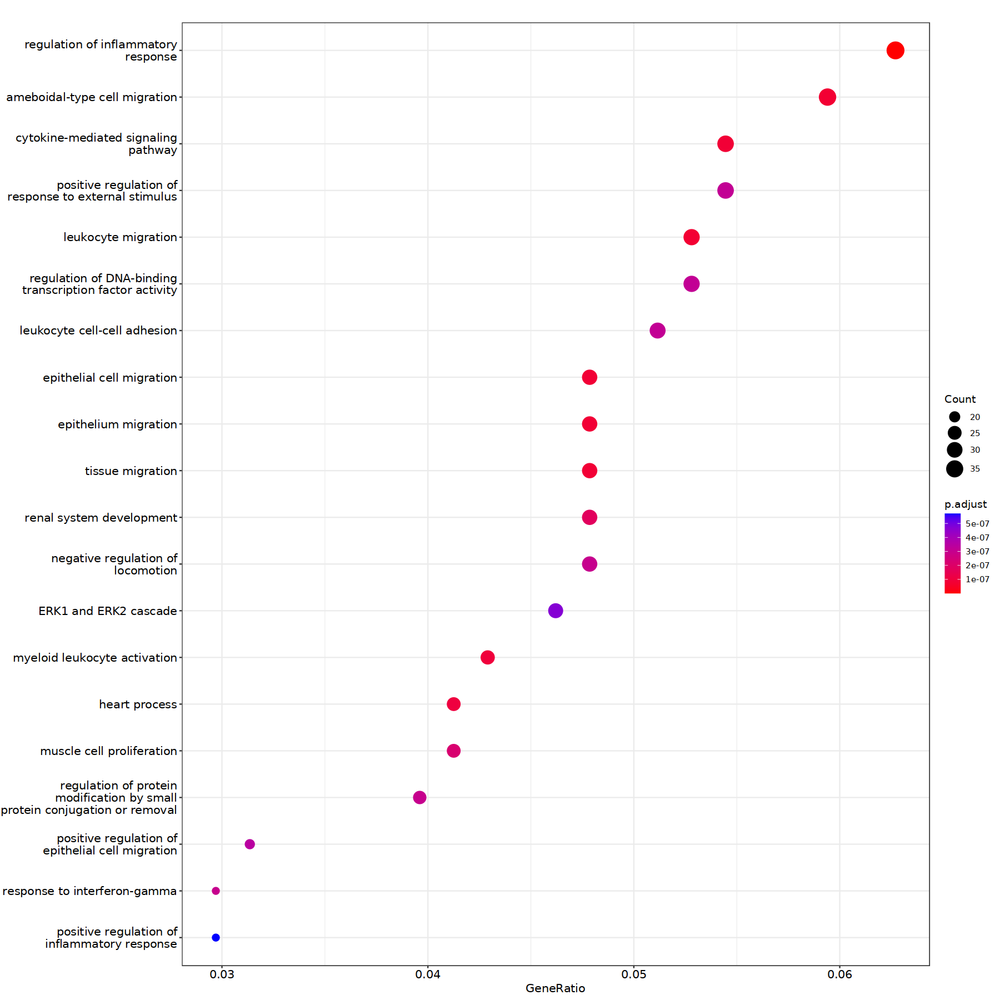

In [28]:
options(repr.plot.height = 15)
a = rownames(results_mk[results_mk$fascia1_trend_class == "显著上调" & results_mk$fascia2_trend_class != "显著上调" & !results_mk$any, ])
sig_DP_entrezId = mapIds(x = org.Mm.eg.db,
                             keys = a,
                             keytype = "SYMBOL",
                             column = "ENTREZID")  
sig_DP_entrezId = na.omit(sig_DP_entrezId)                                                    
go_ALL_a <- enrichGO(gene = sig_DP_entrezId,
                       OrgDb = org.Mm.eg.db,
                       keyType = "ENTREZID",
                       ont = "ALL",
                       pvalueCutoff = 0.05,
                       qvalueCutoff = 0.2,
                       readable = TRUE)
dotplot(go_ALL_a,showCategory=20)

In [29]:
go_ALL_a@result

,ONTOLOGY,ID,Description,GeneRatio,BgRatio,pvalue,p.adjust,qvalue,geneID,Count
,<chr>,<chr>,<chr>,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<chr>,<int>
GO:0050727,BP,GO:0050727,regulation of inflammatory response,38/606,367/28943,6.269275e-16,3.100156e-12,1.967232e-12,Il22ra2/Enpp3/Gpr4/Nlrp10/Rela/Scgb1a1/Jak2/Pik3ap1/Ptger4/Tlr2/Nfkb1/Duoxa2/Tac1/Casp12/Ets1/Trex1/C3/Il1rl1/Il1r1/Cd28/Tnip1/Adora2b/Shpk/Ccl3/Sod1/Cd200/Bcl6/Ccl24/Rabgef1/Il10/Fcer1a/Dusp10/Osm/Fgfr1/Ptpn2/Gpsm3/Ppard/Bcr,38
GO:0001667,BP,GO:0001667,ameboidal-type cell migration,36/606,471/28943,3.099475e-11,7.663452e-08,4.862913e-08,Sash1/Pdcd6/Sema4b/Gab2/Lcn2/Thbs1/Fgf7/Mmp9/Snai1/Tac1/Adipor2/Cyp1b1/Itgb1bp1/Itgb7/Ets1/Robo4/Tpbg/Tgfbr2/Vil1/Ptprm/Adora2b/Gna13/Sox9/Rac1/Pxn/Dusp10/Kdr/Egr3/Vstm4/Fgfr1/Angpt2/Hbegf/Fgf1/Ppard/Arid5b/Timp1,36
GO:0050900,BP,GO:0050900,leukocyte migration,32/606,385/28943,4.651266e-11,7.666837e-08,4.865061e-08,Enpp1/Swap70/Itgam/Ch25h/Ptger4/Tlr2/S1pr1/Thbs1/Mmp9/Ptpro/Padi2/Itgb7/Thy1/Il1r1/Stk10/Tmem102/Ccl3/Ccl4/Cd200/Flt1/Rac1/Ccl24/Rabgef1/Cxcl9/Pf4/Ripk3/Gpr183/Csf1r/Aif1/Gpsm3/Bcr/Msn,32
GO:0010631,BP,GO:0010631,epithelial cell migration,29/606,328/28943,8.805292e-11,8.307037e-08,5.271306e-08,Sash1/Pdcd6/Gab2/Lcn2/Thbs1/Fgf7/Mmp9/Snai1/Tac1/Cyp1b1/Itgb1bp1/Ets1/Robo4/Tgfbr2/Vil1/Ptprm/Adora2b/Sox9/Rac1/Pxn/Dusp10/Kdr/Egr3/Vstm4/Fgfr1/Angpt2/Hbegf/Fgf1/Ppard,29
GO:0090132,BP,GO:0090132,epithelium migration,29/606,330/28943,1.018154e-10,8.307037e-08,5.271306e-08,Sash1/Pdcd6/Gab2/Lcn2/Thbs1/Fgf7/Mmp9/Snai1/Tac1/Cyp1b1/Itgb1bp1/Ets1/Robo4/Tgfbr2/Vil1/Ptprm/Adora2b/Sox9/Rac1/Pxn/Dusp10/Kdr/Egr3/Vstm4/Fgfr1/Angpt2/Hbegf/Fgf1/Ppard,29
GO:0019221,BP,GO:0019221,cytokine-mediated signaling pathway,33/606,421/28943,1.083186e-10,8.307037e-08,5.271306e-08,Il22ra2/Ifitm2/Rela/Slc1a1/Jak2/Irf5/Adipor2/Ripk2/Ugcg/Ifnlr1/Padi2/Csf2rb/Trex1/Il1r1/Il18r1/Ptprn/Crebrf/Slit3/Ccl3/Ccl4/Usp25/Ifnar2/Ifngr2/Ccl24/Rabgef1/Oasl2/Cxcl9/Pf4/Osm/Tnfsf13b/Csf1r/Ptpn2/Il13ra2,33
GO:0090130,BP,GO:0090130,tissue migration,29/606,332/28943,1.175920e-10,8.307037e-08,5.271306e-08,Sash1/Pdcd6/Gab2/Lcn2/Thbs1/Fgf7/Mmp9/Snai1/Tac1/Cyp1b1/Itgb1bp1/Ets1/Robo4/Tgfbr2/Vil1/Ptprm/Adora2b/Sox9/Rac1/Pxn/Dusp10/Kdr/Egr3/Vstm4/Fgfr1/Angpt2/Hbegf/Fgf1/Ppard,29
GO:0002274,BP,GO:0002274,myeloid leukocyte activation,26/606,272/28943,1.533317e-10,9.477813e-08,6.014232e-08,Stx11/Enpp3/Gab2/Itgam/Jak2/Tlr2/Bcl10/Thbs1/Batf/Trex1/Tgfbr2/Il1rl1/Adora2b/Shpk/Trpv1/Ifngr2/Cd200/Rabgef1/Il10/Fcer1a/Batf3/Grp/Cd226/Aif1/Bcr/Il13ra2,26
GO:0003015,BP,GO:0003015,heart process,25/606,254/28943,1.859939e-10,1.021933e-07,6.484770e-08,Hey2/Csrp3/Akap13/Tnni2/Slc1a1/Jak2/Cacna2d1/Tac1/Crhr2/Kcnj8/Epas1/Akap6/Tbx18/Trex1/Trpv1/Nos2/Sod1/Pkp2/Rac1/Rgs2/Rgs4/Nmu/Hbegf/Smad7/Ace2,25


'select()' returned 1:1 mapping between keys and columns



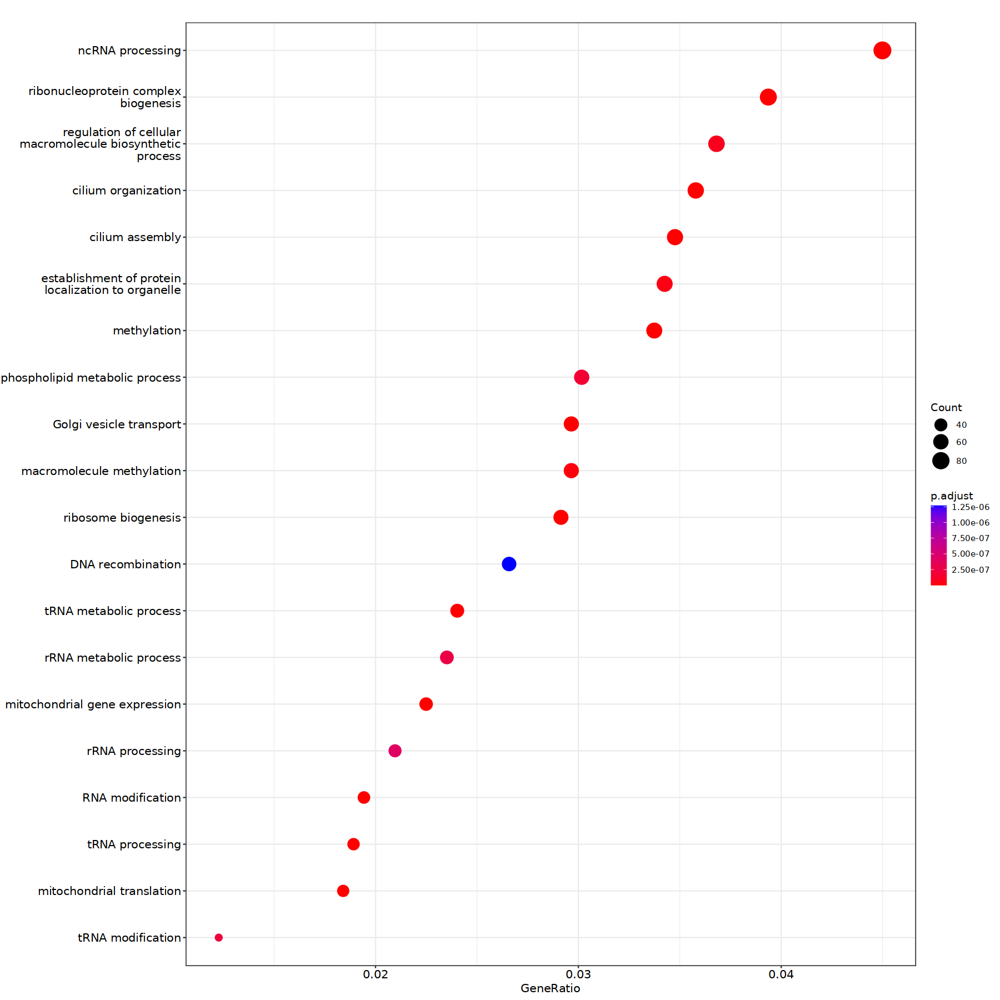

In [30]:
options(repr.plot.height = 15)
b = rownames(results_mk[results_mk$fascia1_trend_class == "显著下调" & results_mk$fascia2_trend_class != "显著下调" & !results_mk$any, ])
sig_DP_entrezId = mapIds(x = org.Mm.eg.db,
                             keys = b,
                             keytype = "SYMBOL",
                             column = "ENTREZID")  
sig_DP_entrezId = na.omit(sig_DP_entrezId)                                                    
go_ALL_b <- enrichGO(gene = sig_DP_entrezId,
                       OrgDb = org.Mm.eg.db,
                       keyType = "ENTREZID",
                       ont = "ALL",
                       pvalueCutoff = 0.05,
                       qvalueCutoff = 0.2,
                       readable = TRUE)
dotplot(go_ALL_b,showCategory=20)

In [32]:
write.csv(go_ALL_a, gzfile("fascia_dev_GO_up.csv.gz"))
write.csv(go_ALL_b, gzfile("fascia_dev_GO_down.csv.gz"))

In [114]:
PRRs_genes <- list( TLRs = c("Tlr1", "Tlr2", "Tlr3", "Tlr4", "Tlr5", "Tlr6", "Tlr7", "Tlr8", "Tlr9", "Tlr11", "Tlr12", "Tlr13"), NLRs = c("Nod1", "Nod2", "Nlrc4", "Nlrp1", "Nlrp3", "Nlrp6", "Nlrp12", "Nlrp10", "Nlrp4a", "Nlrp4b", "Nlrp9b"), RLRs = c("Ddx58", "Ifih1", "Lgp2"), CLRs = c("Clec4e", "Clec4d", "Clec7a", "Clec9a", "Clec12a", "Clec4n", "Clec4a", "Clec4f", "Clec4g", "Clec4m"), ALRs = c("Ifi16", "Aim2") )

In [115]:
for (i in names(PRRs_genes)){
    print(i)
    print(results_mk[PRRs_genes[[i]],])
}

[1] "TLRs"
      fascia1_tau fascia1_p_value  fascia1_FDR fascia1_trend_class fascia2_tau
Tlr1  -0.02365422    0.7752633095 0.9689669000              不显著  0.05431389
Tlr2   0.48591965    0.0000000000 0.0000000000            显著上调  0.03349460
Tlr3   0.26673719    0.0001413822 0.0004597175            显著上调  0.29294112
Tlr4   0.17499729    0.0106524229 0.0261195213              不显著  0.10124280
Tlr5  -0.24928840    0.0003330442 0.0010341471              不显著 -0.04363313
Tlr6  -0.21194011    0.0034554699 0.0092389530              不显著 -0.06569058
Tlr7   0.17181131    0.0318074226 0.0699853093              不显著 -0.08768719
Tlr8   0.10505515    0.1911041737 0.3213280341              不显著 -0.11208561
Tlr9  -0.04428346    0.6033136845 0.8033391265              不显著  1.00000000
Tlr11  0.03856946    0.6524538994 0.8515863380              不显著  0.17519043
Tlr12 -0.05881657    0.4706228375 0.6620906326              不显著  0.01613491
NA             NA              NA           NA                <NA>          

In [116]:
receptors <- c("Tlr2", "Tlr4", "Tlr9", "Rage", "Tim3", "Il1r", "St2", "P2ry2", "P2rx7", "Clec9a", "Bsg", "Lrp1", "Scarf1", "Stab1", "Nlrp3")
results_mk[receptors,]

,fascia1_tau,fascia1_p_value,fascia1_FDR,fascia1_trend_class,fascia2_tau,fascia2_p_value,fascia2_FDR,fascia2_trend_class,No_anno,RIKEN,Mito,Ribo,Hb,any
,<dbl>,<dbl>,<dbl>,<chr>,<dbl>,<dbl>,<dbl>,<chr>,<lgl>,<lgl>,<lgl>,<lgl>,<lgl>,<lgl>
Tlr2,0.48591965,0.000000e+00,0.000000e+00,显著上调,0.033494599,6.658708e-01,8.808167e-01,不显著,FALSE,FALSE,FALSE,FALSE,FALSE,FALSE
Tlr4,0.17499729,1.065242e-02,2.611952e-02,不显著,0.101242803,1.364657e-01,2.646133e-01,不显著,FALSE,FALSE,FALSE,FALSE,FALSE,FALSE
Tlr9,-0.04428346,6.033137e-01,8.033391e-01,不显著,1.000000000,1.000000e+00,1.000000e+00,不显著,FALSE,FALSE,FALSE,FALSE,FALSE,FALSE
NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA
NA.1,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA
NA.2,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA
NA.3,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA
P2ry2,0.62315816,0.000000e+00,0.000000e+00,显著上调,0.509265065,0.000000e+00,0.000000e+00,显著上调,FALSE,FALSE,FALSE,FALSE,FALSE,FALSE
P2rx7,0.06297536,3.767526e-01,5.550207e-01,不显著,0.148024306,3.293538e-02,8.254586e-02,不显著,FALSE,FALSE,FALSE,FALSE,FALSE,FALSE


In [124]:
rar_genes <- c("Rara", "Rarb", "Rarg")
results_mk[rar_genes,]

,fascia1_tau,fascia1_p_value,fascia1_FDR,fascia1_trend_class,fascia2_tau,fascia2_p_value,fascia2_FDR,fascia2_trend_class,No_anno,RIKEN,Mito,Ribo,Hb,any
,<dbl>,<dbl>,<dbl>,<chr>,<dbl>,<dbl>,<dbl>,<chr>,<lgl>,<lgl>,<lgl>,<lgl>,<lgl>,<lgl>
Rara,-0.45252520,2.593063e-11,1.533000e-10,显著下调,-0.2391919,0.0004265106,0.001704301,不显著,FALSE,FALSE,FALSE,FALSE,FALSE,FALSE
Rarb,0.07111111,2.958755e-01,4.576700e-01,不显著,0.1175757,0.0835791826,0.179163063,不显著,FALSE,FALSE,FALSE,FALSE,FALSE,FALSE
Rarg,-0.16848484,1.310985e-02,3.153872e-02,不显著,0.1074747,0.1137911081,0.229183257,不显著,FALSE,FALSE,FALSE,FALSE,FALSE,FALSE


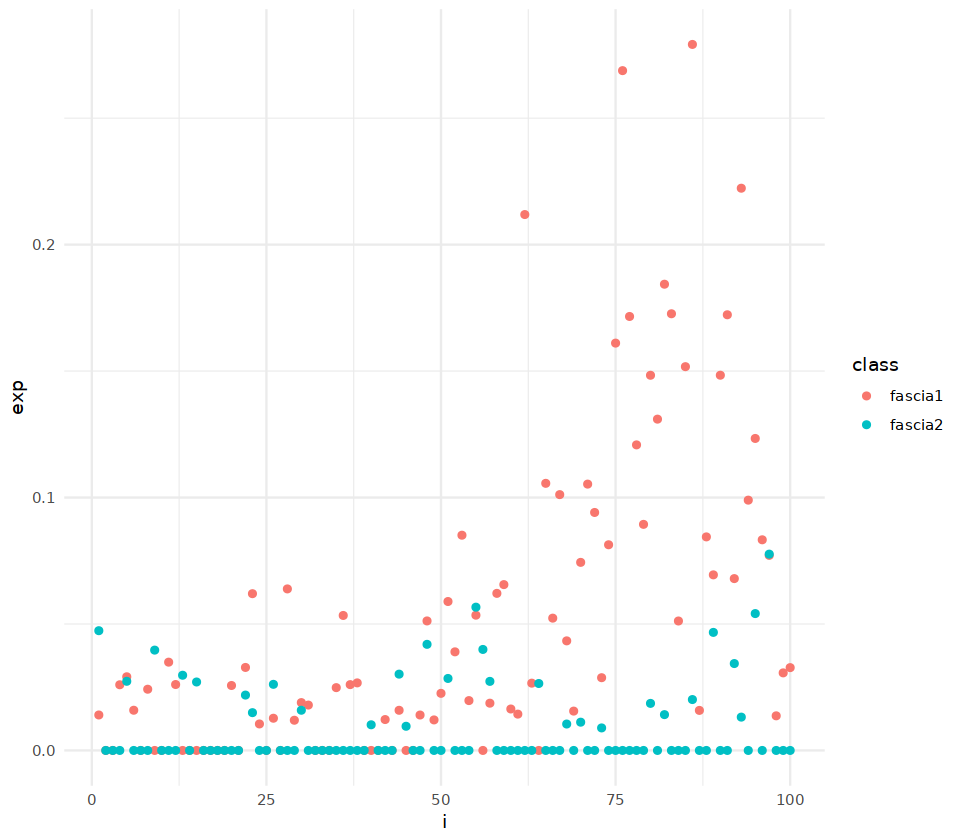

In [137]:
gene = "Tlr2"
options(repr.plot.width = 8, repr.plot.height = 7)
df = data.frame(i=as.numeric(c(colnames(mat_f1_), colnames(mat_f1_))), exp=c(mat_f1_[gene,], mat_f2_[gene,]), class=c(rep("fascia1", ncol(mat_f1_)), rep("fascia2", ncol(mat_f2_))))
ggplot(data=df, aes(x=i, y=exp, color=class)) + geom_point() + theme_minimal()

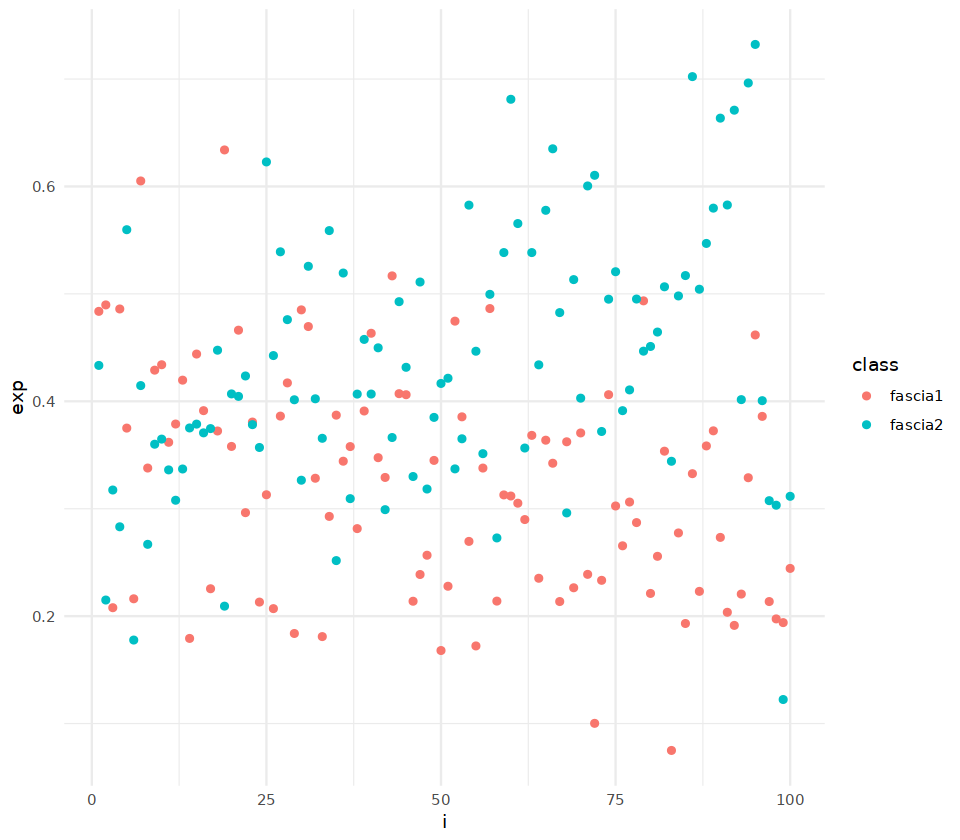

In [33]:
gene = "Tsku"
options(repr.plot.width = 8, repr.plot.height = 7)
df = data.frame(i=as.numeric(c(colnames(mat_f1_), colnames(mat_f1_))), exp=c(mat_f1_[gene,], mat_f2_[gene,]), class=c(rep("fascia1", ncol(mat_f1_)), rep("fascia2", ncol(mat_f2_))))
ggplot(data=df, aes(x=i, y=exp, color=class)) + geom_point() + theme_minimal()

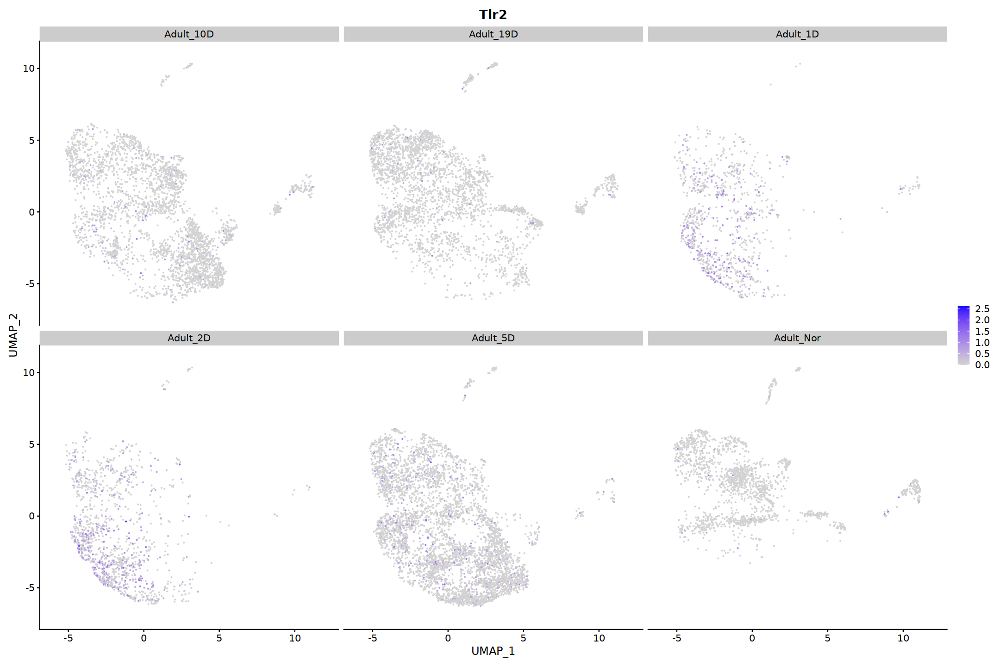

In [142]:
options(repr.plot.width = 18, repr.plot.height = 12)
FeaturePlot(obj_adult, "Tlr2", raster=F) + facet_wrap(~obj_adult$Age_TimePostInjury)

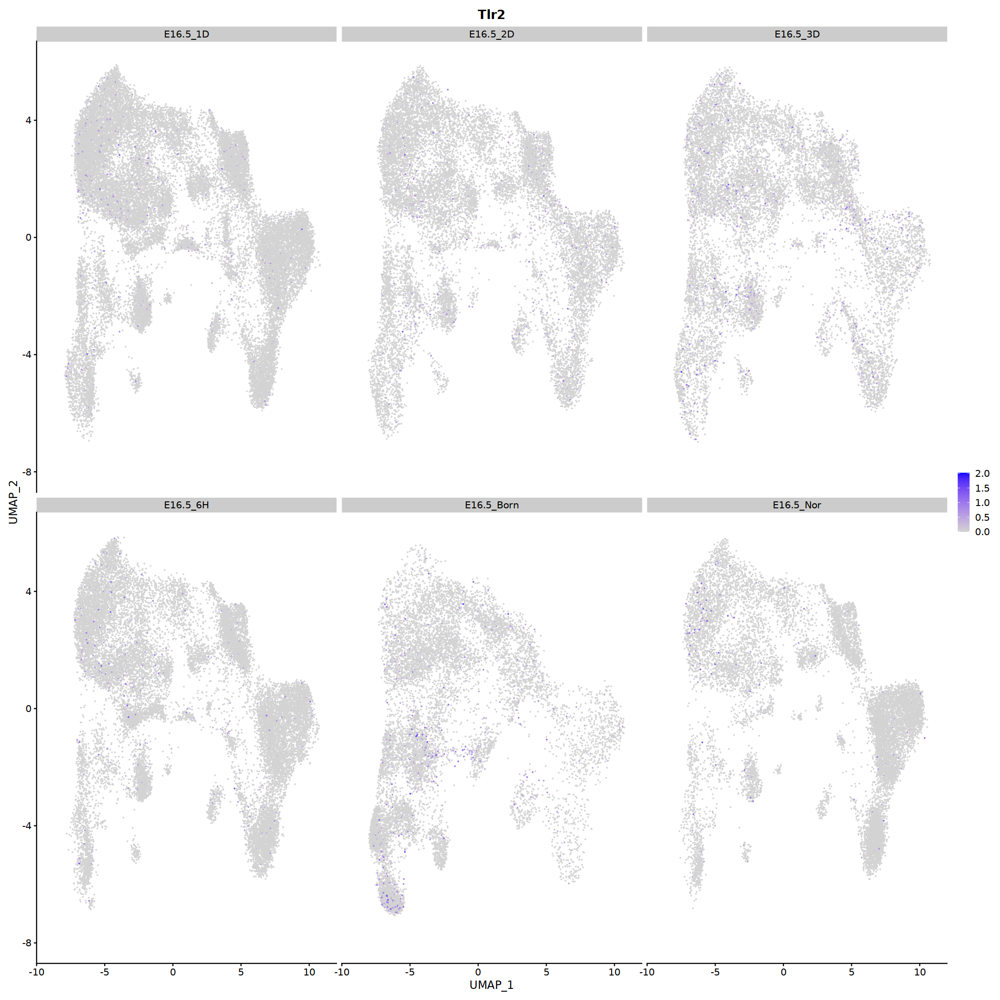

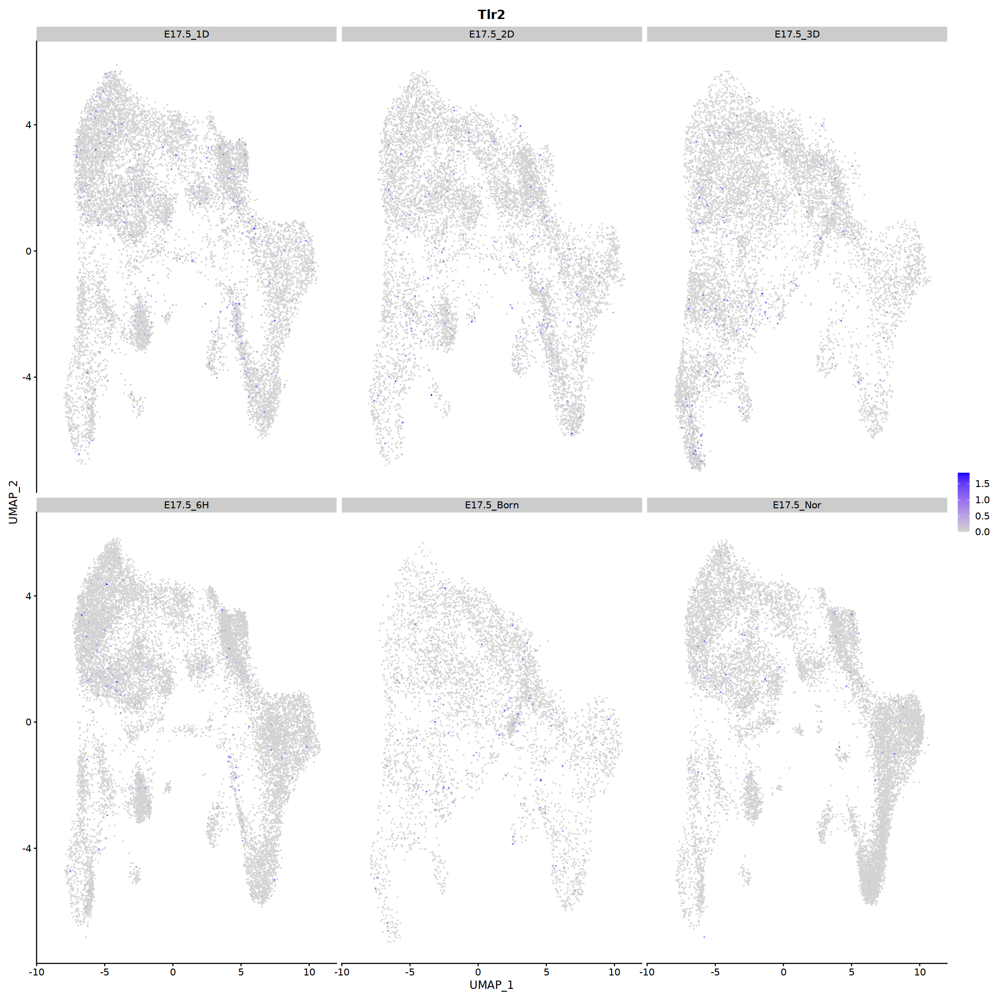

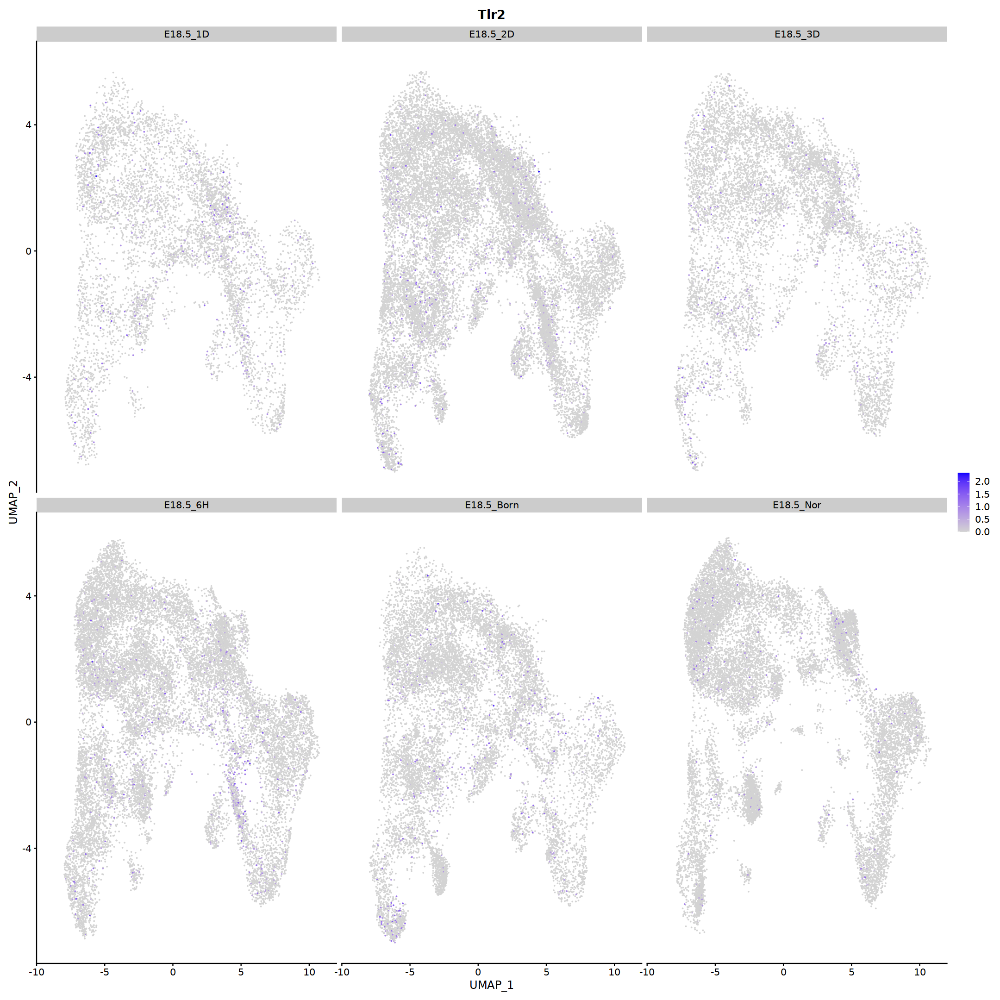

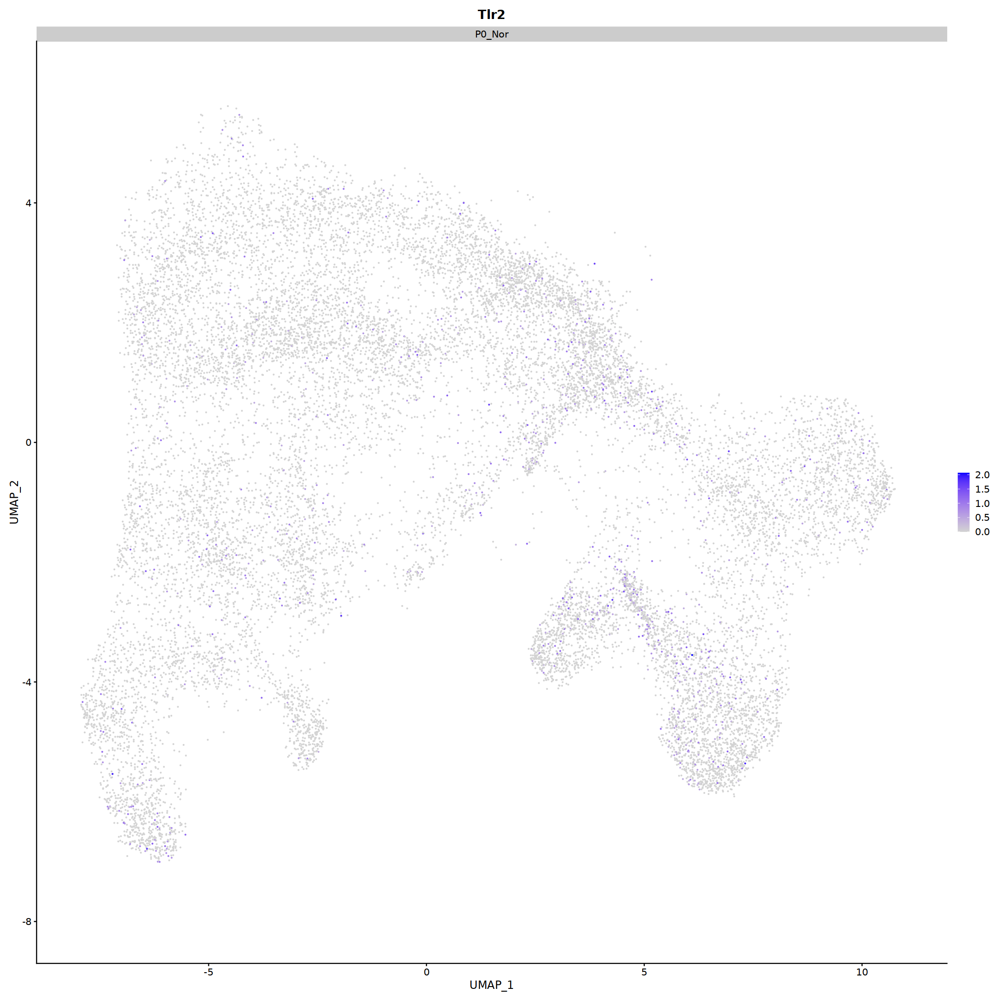

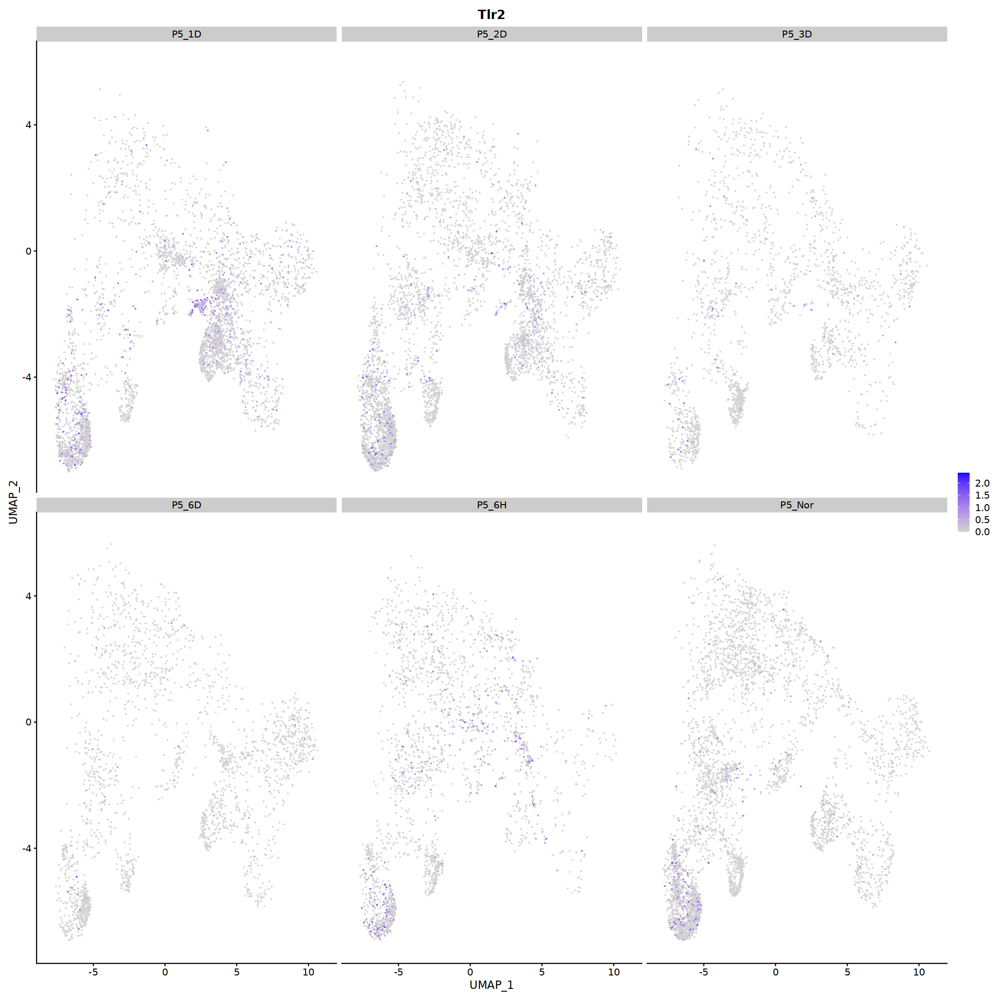

In [5]:
options(repr.plot.width = 18, repr.plot.height = 18)
for (i in unique(obj_ep$Age)){
p<-FeaturePlot(obj_ep[,obj_ep$Age==i], "Tlr2", raster=F) + facet_wrap(~obj_ep[,obj_ep$Age==i]$Age_TimePostInjury)
print(p)}

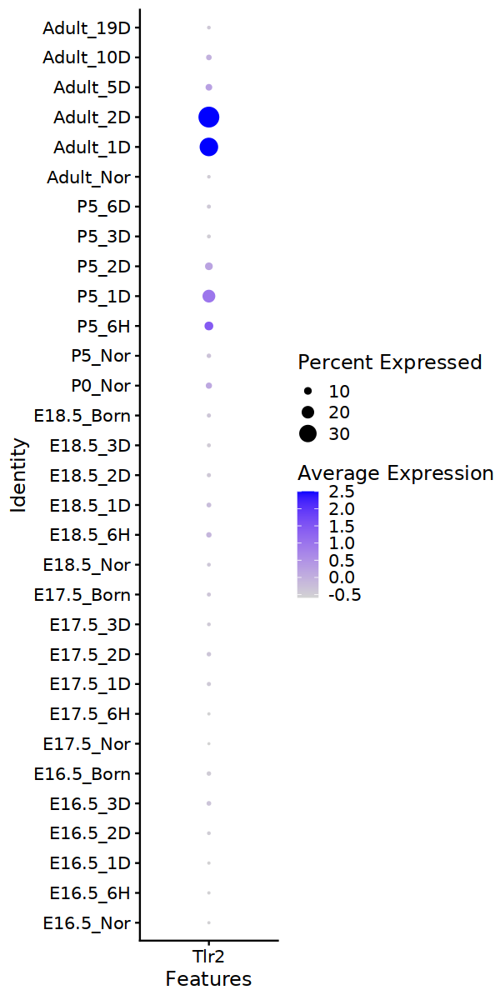

In [10]:
options(repr.plot.width = 5, repr.plot.height = 10)
obj_fascia$Age_TimePostInjury = factor(obj_fascia$Age_TimePostInjury, c("E16.5_Nor", "E16.5_6H", "E16.5_1D", "E16.5_2D", "E16.5_3D", "E16.5_Born",
             "E17.5_Nor", "E17.5_6H", "E17.5_1D", "E17.5_2D", "E17.5_3D", "E17.5_Born",
             "E18.5_Nor", "E18.5_6H", "E18.5_1D", "E18.5_2D", "E18.5_3D", "E18.5_Born",
             "P0_Nor", "P5_Nor", "P5_6H", "P5_1D", "P5_2D", "P5_3D", "P5_6D",
             "Adult_Nor", "Adult_1D", "Adult_2D", "Adult_5D", "Adult_10D", "Adult_19D"))

DotPlot(obj_fascia, features="Tlr2", group.by="Age_TimePostInjury")

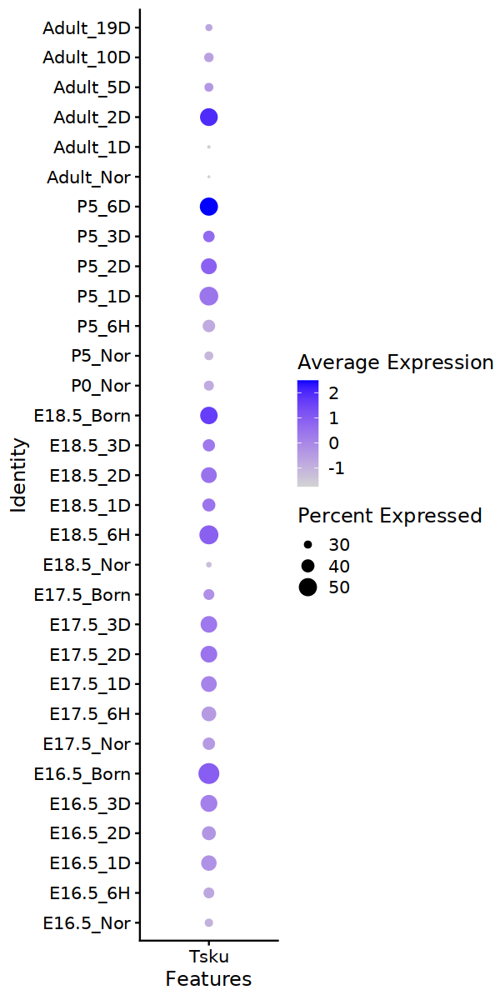

In [36]:
options(repr.plot.width = 5, repr.plot.height = 10)
obj_fascia$Age_TimePostInjury = factor(obj_fascia$Age_TimePostInjury, c("E16.5_Nor", "E16.5_6H", "E16.5_1D", "E16.5_2D", "E16.5_3D", "E16.5_Born",
             "E17.5_Nor", "E17.5_6H", "E17.5_1D", "E17.5_2D", "E17.5_3D", "E17.5_Born",
             "E18.5_Nor", "E18.5_6H", "E18.5_1D", "E18.5_2D", "E18.5_3D", "E18.5_Born",
             "P0_Nor", "P5_Nor", "P5_6H", "P5_1D", "P5_2D", "P5_3D", "P5_6D",
             "Adult_Nor", "Adult_1D", "Adult_2D", "Adult_5D", "Adult_10D", "Adult_19D"))

DotPlot(obj_fascia, features="Tsku", group.by="Age_TimePostInjury")

In [37]:
obj_adult$Age_TimePostInjury = factor(obj_adult$Age_TimePostInjury, c("E16.5_Nor", "E16.5_6H", "E16.5_1D", "E16.5_2D", "E16.5_3D", "E16.5_Born",
             "E17.5_Nor", "E17.5_6H", "E17.5_1D", "E17.5_2D", "E17.5_3D", "E17.5_Born",
             "E18.5_Nor", "E18.5_6H", "E18.5_1D", "E18.5_2D", "E18.5_3D", "E18.5_Born",
             "P0_Nor", "P5_Nor", "P5_6H", "P5_1D", "P5_2D", "P5_3D", "P5_6D",
             "Adult_Nor", "Adult_1D", "Adult_2D", "Adult_5D", "Adult_10D", "Adult_19D"))


In [38]:
obj_ep$Age_TimePostInjury = factor(obj_ep$Age_TimePostInjury, c("E16.5_Nor", "E16.5_6H", "E16.5_1D", "E16.5_2D", "E16.5_3D", "E16.5_Born",
             "E17.5_Nor", "E17.5_6H", "E17.5_1D", "E17.5_2D", "E17.5_3D", "E17.5_Born",
             "E18.5_Nor", "E18.5_6H", "E18.5_1D", "E18.5_2D", "E18.5_3D", "E18.5_Born",
             "P0_Nor", "P5_Nor", "P5_6H", "P5_1D", "P5_2D", "P5_3D", "P5_6D",
             "Adult_Nor", "Adult_1D", "Adult_2D", "Adult_5D", "Adult_10D", "Adult_19D"))

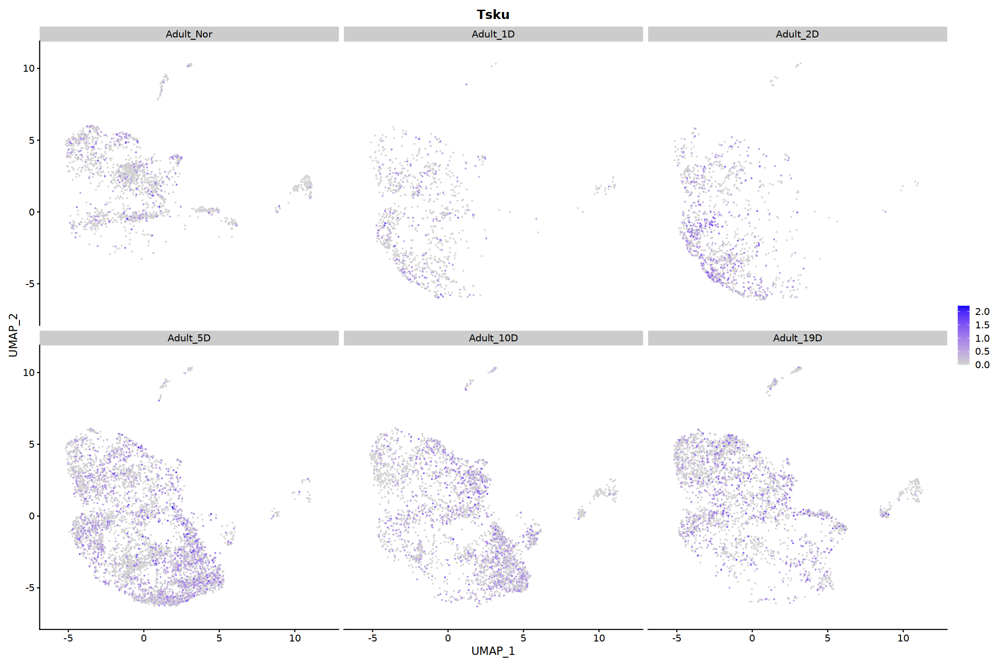

In [39]:
options(repr.plot.width = 18, repr.plot.height = 12)
FeaturePlot(obj_adult, "Tsku", raster=F) + facet_wrap(~obj_adult$Age_TimePostInjury)

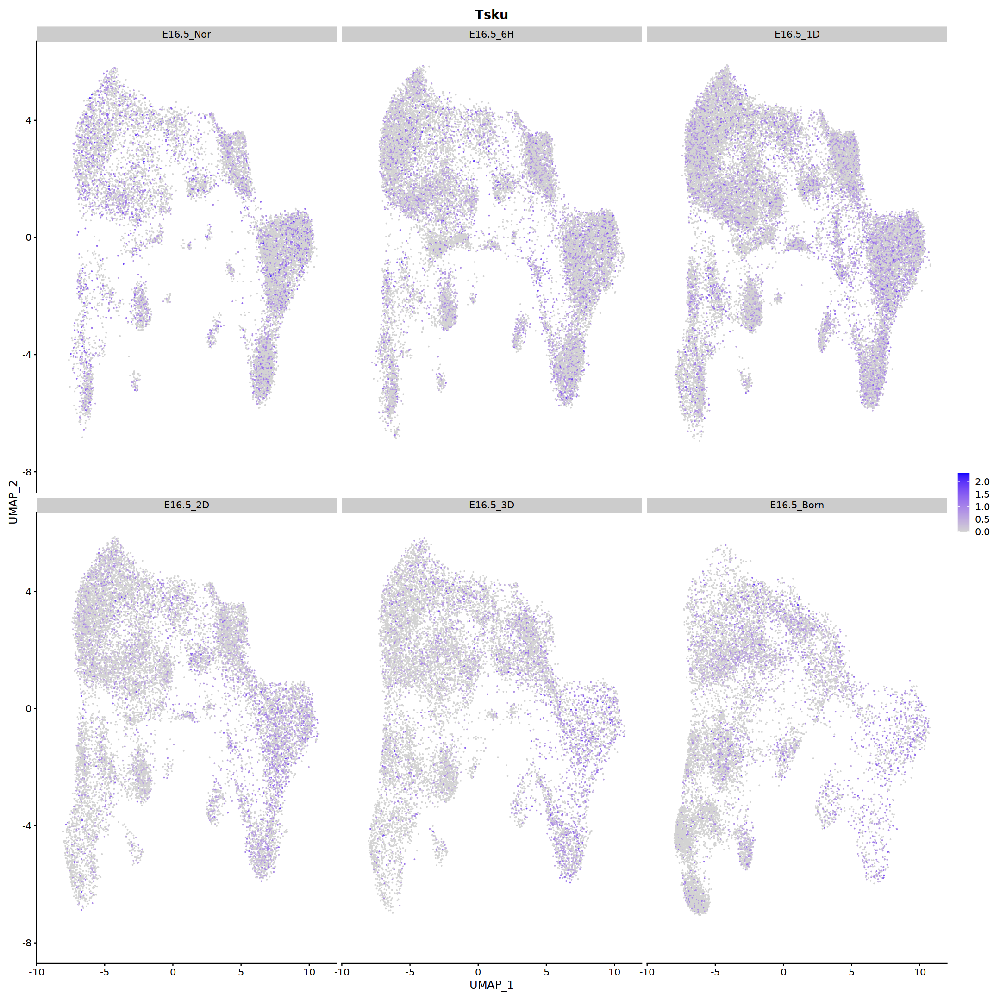

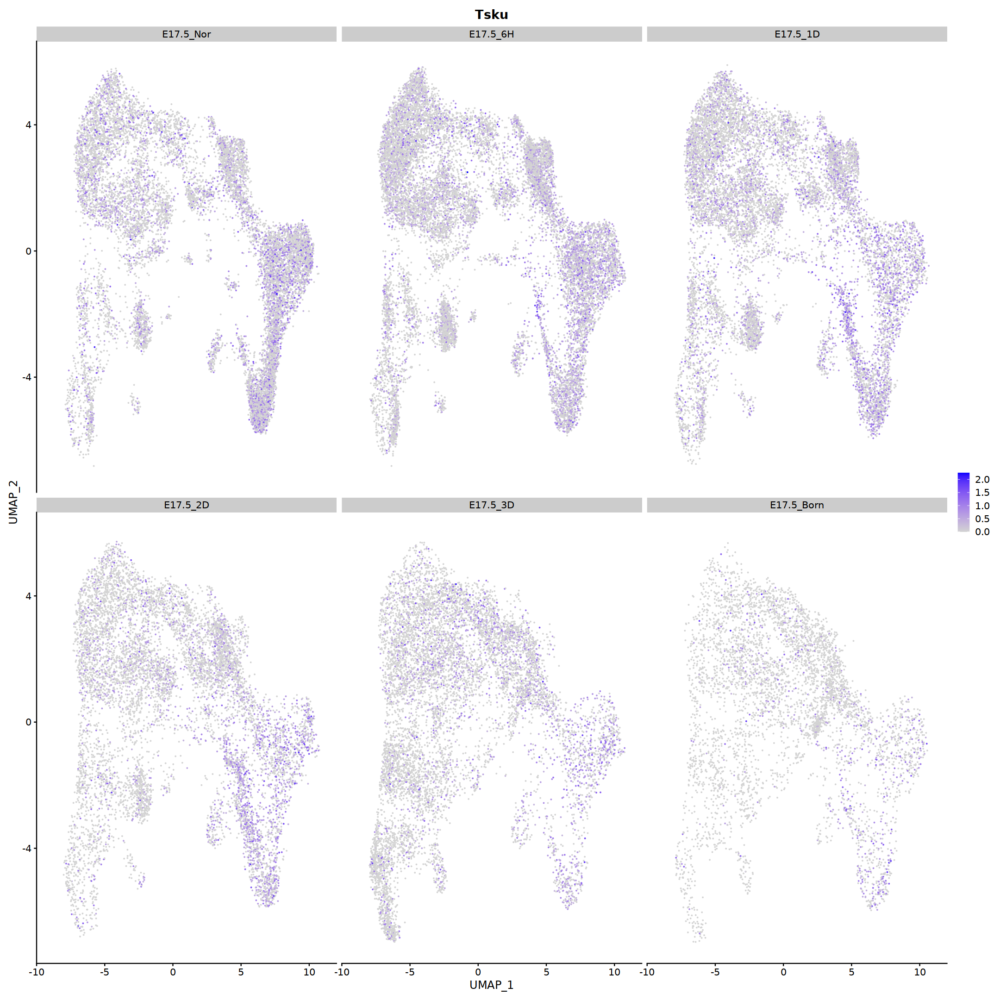

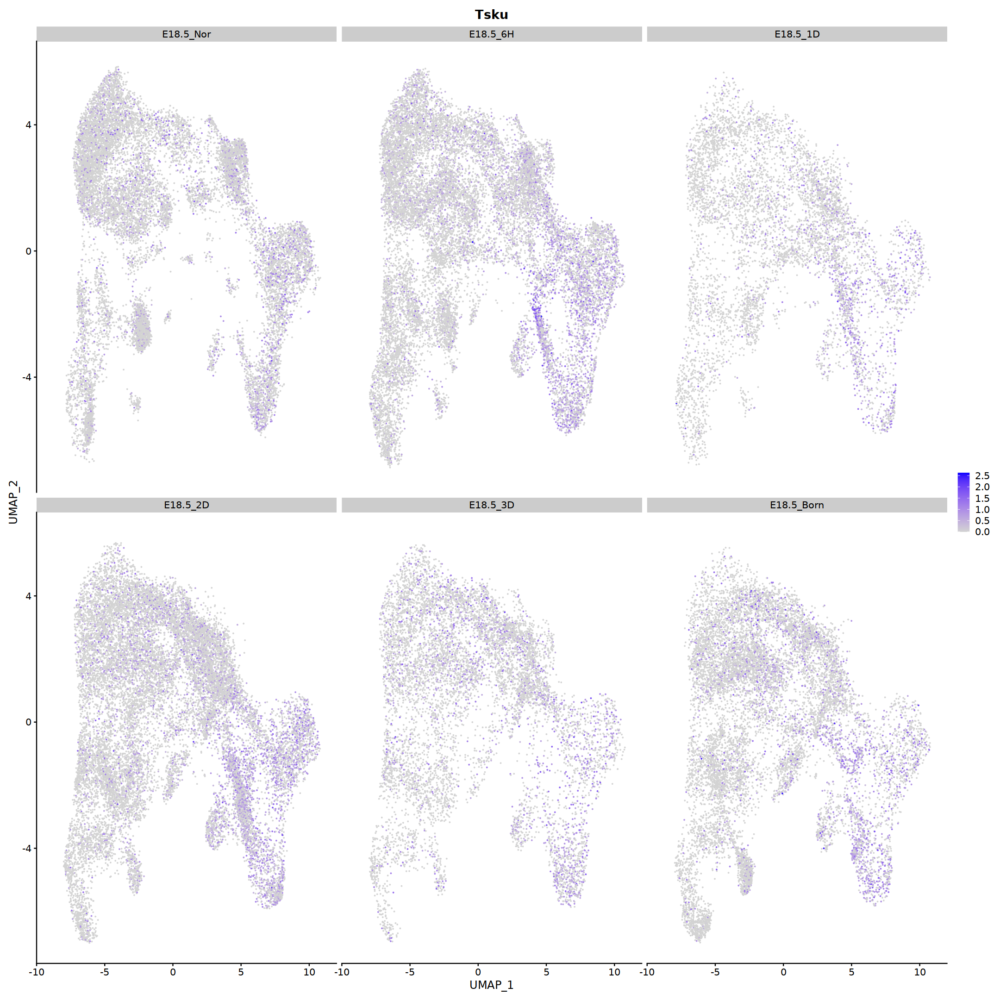

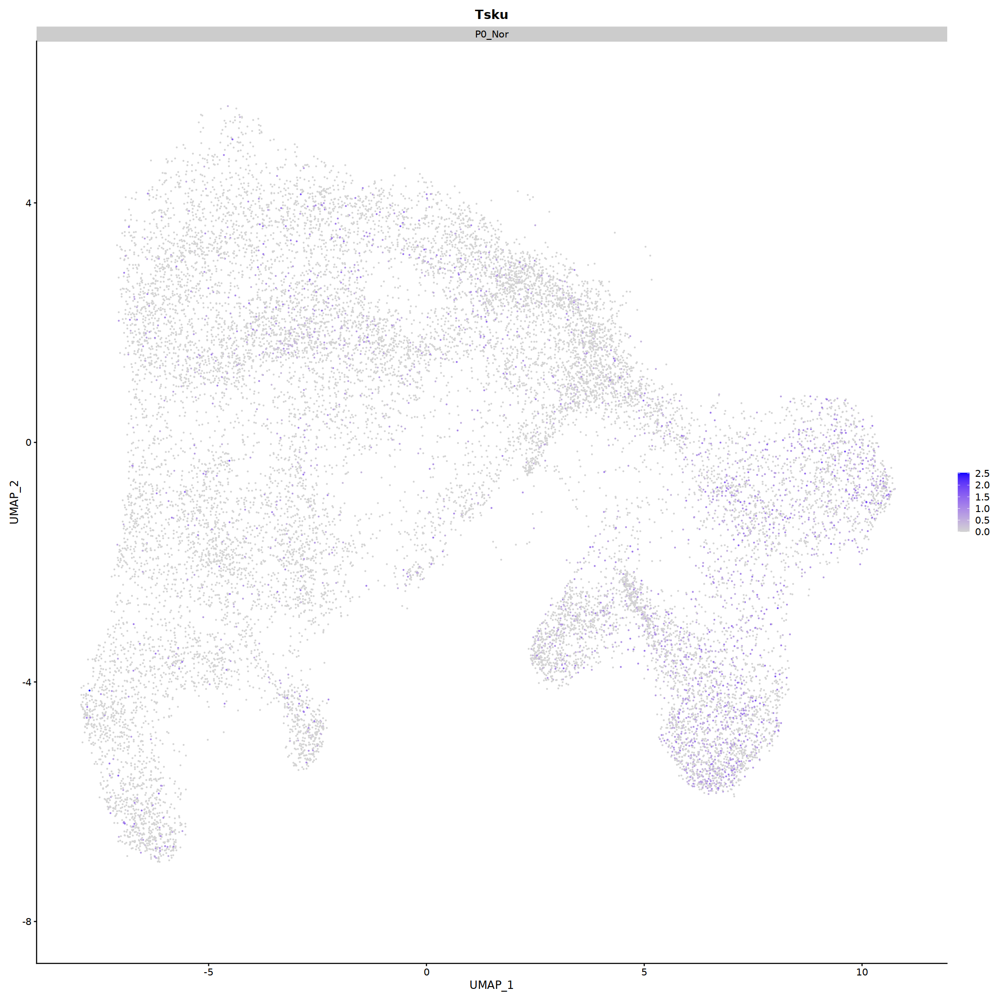

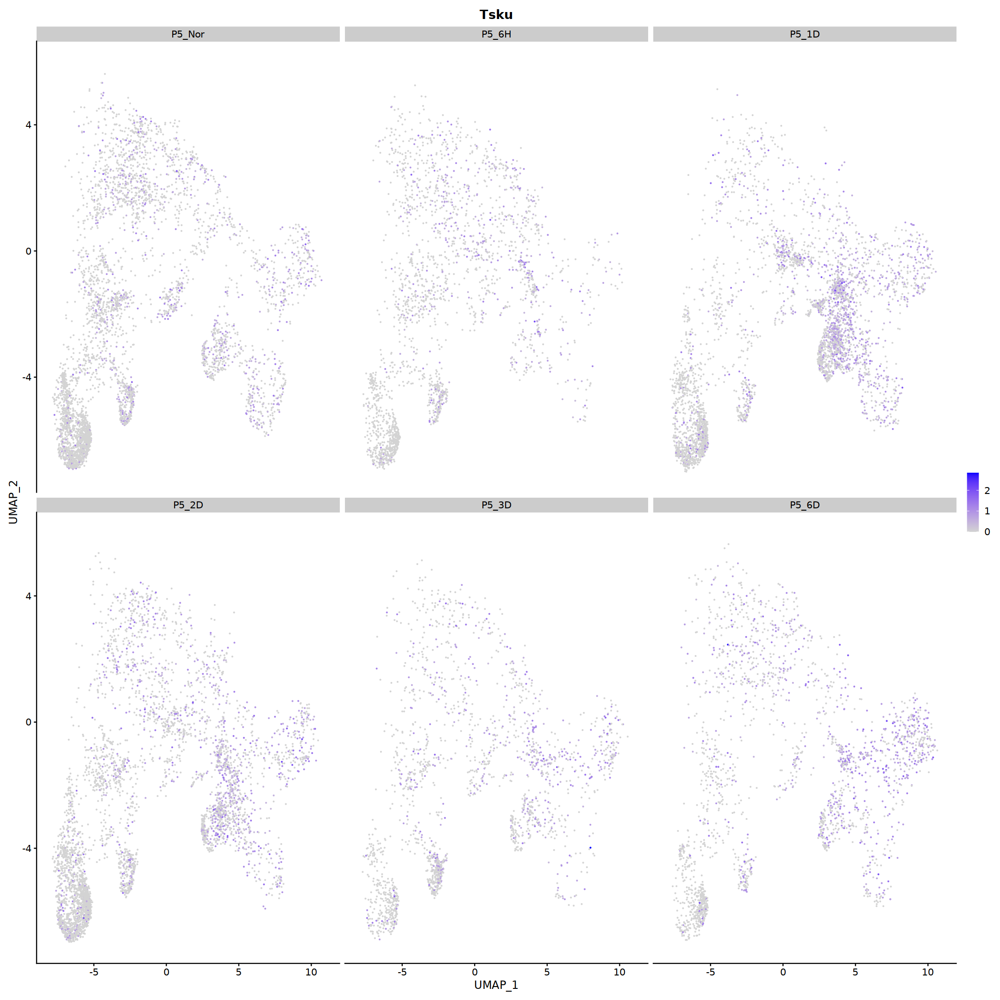

In [44]:
options(repr.plot.width = 18, repr.plot.height = 18)
for (i in unique(obj_ep$Age)){
p<-FeaturePlot(obj_ep[,obj_ep$Age==i], "Tsku", raster=F) + facet_wrap(~obj_ep[,obj_ep$Age==i]$Age_TimePostInjury)
print(p)}

In [41]:
rm(obj_adult)
gc()

,used,(Mb),gc trigger,(Mb),max used,(Mb)
Ncells,7579790,404.9,19933637,1064.6,31146307,1663.4
Vcells,4845449041,36967.9,7135105539,54436.6,5058440449,38592.9


In [42]:
obj_ep = obj_ep[c("Tsku","Tlr2"),]


In [43]:
gc()

,used,(Mb),gc trigger,(Mb),max used,(Mb)
Ncells,7579967,404.9,19933637,1064.6,31146307,1663.4
Vcells,1048379043,7998.5,5708084432,43549.3,5058440449,38592.9


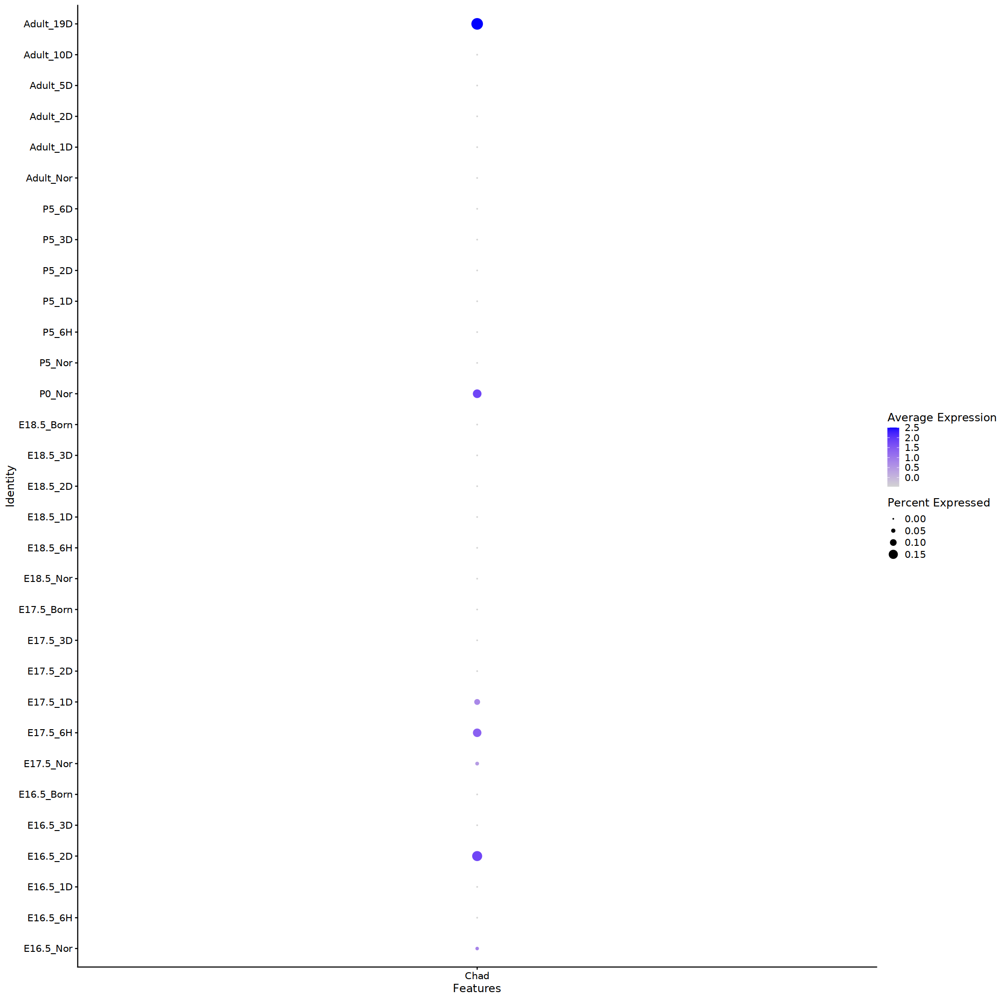

In [45]:
DotPlot(obj_fascia, features=c("Chad","Nyx","Tsk"), group.by="Age_TimePostInjury")